In [ ]:
import numpy as np
import math
import torch
from PIL import Image
from torchvision import datasets, transforms
from torch.nn.utils import weight_norm
from torch.utils.data import DataLoader
import torch
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
from torch.autograd import Variable
import torch.nn.functional as F
import copy
import numpy as np
import torchvision.utils as vutils
import time
import matplotlib.pyplot as plt   
import torchvision.utils as vutils
classes = 10
train_total = 50000


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:

#modified from: 
#https://github.com/kekmodel/FixMatch-pytorch/blob/master/dataset/cifar.py 
def x_u_split(labels, labeled_per_class):
    np.random.seed(0) #make sure split are the same
    labels = np.array(labels)
    labeled_idx = []
    for i in range(classes):
        idx = np.where(labels == i)[0]
        idx = np.random.choice(idx, labeled_per_class, False)
        labeled_idx.extend(idx)
    labeled_idx = np.array(labeled_idx)
    np.random.shuffle(labeled_idx)
    np.random.seed() #optionally restore rng
    return labeled_idx, np.setdiff1d(range(train_total), labeled_idx)

class CIFAR100SSL(datasets.CIFAR10):
    def __init__(self, root, indexs, train=True,
                 transform=None, target_transform=None,
                 download=True):
        super().__init__(root, train=train,
                         transform=transform,
                         target_transform=target_transform,
                         download=download)
        if indexs is not None:
            self.data = self.data[indexs]
            self.targets = np.array(self.targets)[indexs]

    def __getitem__(self, index):
        img, target = self.data[index], self.targets[index]
        img = Image.fromarray(img)

        if self.transform is not None:
            img = self.transform(img)

        if self.target_transform is not None:
            target = self.target_transform(target)

        return img, target


In [ ]:

mean,std = (0.5071, 0.4867, 0.4408), (0.2675, 0.2565, 0.2761)

# might change data agumentation
transform_labeled = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize(mean,std)])

transform_unlabeled = transforms.Compose([
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize(mean,std)]) #AddGaussianNoise()

transform_test = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean,std)])

In [ ]:
root = './tmp'
#adjust this for labeled and unlabed split
labeled_per_class = 500

base_dataset = datasets.CIFAR10(
    root, train=True, download=True)

train_labeled_idxs, train_unlabeled_idxs = x_u_split(base_dataset.targets, labeled_per_class)

train_labeled_dataset = CIFAR100SSL(
    root, train_labeled_idxs, train=True,
    transform=transform_labeled)

train_unlabeled_dataset = CIFAR100SSL(
    root, train_unlabeled_idxs, train=True,
    transform=transform_unlabeled)

test_dataset = datasets.CIFAR10(
    root, train=False, transform=transform_test, download=False)

  0%|          | 0/170498071 [00:00<?, ?it/s]

Extracting ./tmp/cifar-10-python.tar.gz to ./tmp
Files already downloaded and verified
Files already downloaded and verified


In [ ]:
u_train_batch_size = l_train_batch_size = val_batch_size = batch_size = 128
l_train_dataloader = DataLoader(train_labeled_dataset, batch_size=batch_size, shuffle=True)
u_train_dataloader = DataLoader(train_unlabeled_dataset, batch_size=batch_size, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=len(test_dataset), shuffle=False)

In [ ]:
nz = 100
nc = 3
lr_gen = lr_cla = lr = 0.0003
num_epochs = 600
train_interval_gen = 1
train_interval_dis = 1
clamp_max = 0.01
ngf = 64 # num of feature maps in generator
ndf = 32 # num of feature maps in generator
fm_layer = 'avgpool' #for Resnet feature_matching layer: 'layer1','layer2','layer3','layer4','avgpool','fc'
mul = 1 #scale loss on labelled data to match with wasserstein loss
Feature_match = True #whether to use feature matching
label_smooth = 1

In [ ]:

class Discriminator(nn.Module):
        def __init__(self,num_classes):
            super(Discriminator, self).__init__()
            self.net = nn.Sequential(
                    nn.Dropout(.2),
                    weight_norm(nn.Conv2d(3,ndf * 3,3,stride=1,padding=1)),
                    nn.LeakyReLU(),
                    weight_norm(nn.Conv2d(ndf * 3,ndf * 3,3,stride=1,padding=1)),
                    nn.LeakyReLU(),
                    weight_norm(nn.Conv2d(ndf * 3,ndf * 3,3,stride=2,padding=1)),
                    nn.LeakyReLU(),

                    nn.Dropout(.5),
                    weight_norm(nn.Conv2d(ndf * 3,ndf * 6,3,stride=1,padding=1)),
                    nn.LeakyReLU(),
                    weight_norm(nn.Conv2d(ndf * 6,ndf * 6,3,stride=1,padding=1)),
                    nn.LeakyReLU(),
                    weight_norm(nn.Conv2d(ndf * 6,ndf * 6,3,stride=2,padding=1)),
                    nn.LeakyReLU(),
                    
                    nn.Dropout(.5),
                    weight_norm(nn.Conv2d(ndf * 6,ndf * 6,3,stride=1,padding=0)),
                    nn.LeakyReLU(),
                    weight_norm(nn.Conv2d(ndf * 6,ndf * 6,1,stride=1,padding=0)),
                    nn.LeakyReLU(),
                    weight_norm(nn.Conv2d(ndf * 6,ndf * 6,1,stride=1,padding=0)),
                    nn.LeakyReLU(),

                    # nn.AvgPool2d(6,stride=1),
                    nn.AdaptiveAvgPool2d(1),
                    nn.Flatten()
                )

            self.fc = weight_norm(nn.Linear(ndf * 6,num_classes))
            
        def forward(self,x):
            inter_layer = self.net(x)
            logits = self.fc(inter_layer)
            return inter_layer, logits

In [ ]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # input is Z, going into a convolution


            # state size. (ngf*16) x 4 x 4
            nn.ConvTranspose2d( ngf*8, ngf * 4, 4, 2, 1),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(),
            # state size. (ngf*8) x 8 x 8
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(),
            # state size. (ngf*4) x 16 x 16
            weight_norm(nn.ConvTranspose2d( ngf * 2, nc, 4, 2, 1)),
            nn.Tanh()
            # state size. (nc) x 32 x 32
        )
        self.enlargenoise = nn.Sequential(
            nn.Linear(nz, ngf * 8 * 4 * 4),
            nn.BatchNorm1d(ngf * 8 * 4 * 4),
            nn.ReLU(),
        )

    def forward(self, input):
        x = self.enlargenoise(input.squeeze())
        x = x.view((-1,ngf*8,4,4))
        return self.main(x)

In [ ]:
def init_normal(m):
        if type(m) == nn.Linear:
            nn.init.normal_(m.weight,mean=.0,std=.05)
            nn.init.constant_(m.bias,.0)

        if type(m) == nn.ConvTranspose2d:
            nn.init.normal_(m.weight,mean=0,std=.05)


In [ ]:
class FeatureExtractor(nn.Module):

    def __init__(self, submodule, extracted_layers):

        super(FeatureExtractor, self).__init__()

        self.submodule = submodule.cuda()

        self.extracted_layers = extracted_layers

    def forward(self, x):
        out_dict={}
        for name, module in self.submodule._modules.items():

            if name is "fc": x = x.view(x.size(0), -1)

            x = module(x)

            if name in self.extracted_layers:

                out_dict[name]=x
        return out_dict

In [ ]:
def test(model, test_loader, m_test, display = False):
    model.eval()
    test_loss = 0
    correct = 0
    with torch.no_grad():
        for label_image, label in test_loader:
            label_image,label = label_image.cuda(),label.cuda()
            _,output = model(label_image)
            test_loss += criterion_C(output, label).item() 
            pred = output.argmax(dim=1, keepdim=True)
            correct += pred.eq(label.view_as(pred)).sum().item()

    test_loss /= len(test_loader)

    if display == True:
        print('\nTest set: Average loss: {:.4f}, Accuracy: {}/{} ({:.0f}%)\n'.format(
        test_loss, correct, m_test,
        100. * correct / m_test))
           
    return test_loss, 100. * correct / m_test/len(test_loader)


In [ ]:
def wasserstein_loss(y_true, y_pred):
    return torch.mean(y_true * y_pred)
def log_sum_exp(x, axis = 1):
    m = torch.max(x, dim = 1)[0]    
    return m + torch.log(torch.sum(torch.exp(x- m.unsqueeze(1)), dim = axis)) 

In [ ]:
netG = Generator().apply(init_normal).cuda()
netDC = Discriminator(10).apply(init_normal).cuda()

In [ ]:
optimizer_G  = torch.optim.RMSprop(netG.parameters(), lr=lr)
optimizer_DC  = torch.optim.RMSprop(netDC.parameters(), lr=lr)
scheduler_G = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_G, mode='min', factor=0.5, patience=30, verbose=True, threshold=0.0001, threshold_mode='rel', cooldown=0, min_lr=0, eps=1e-08)
scheduler_DC = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_DC, mode='min', factor=0.5, patience=30, verbose=True, threshold=0.0001, threshold_mode='rel', cooldown=0, min_lr=0, eps=1e-08)

criterion_C = nn.CrossEntropyLoss().cuda()
criterion_G = nn.MSELoss().cuda()

fixed_noise = torch.randn(batch_size,nz).cuda()


G_losses = []
DC_losses = []

best_model_wts = copy.deepcopy(netDC.state_dict())
best_acc = 0.0


Test set: Average loss: 1.9846, Accuracy: 1798/5000 (36%)


Test set: Average loss: 2.1163, Accuracy: 3400/10000 (34%)

ETA of completion: 763.2663416862488 minutes: curr_epoch 0


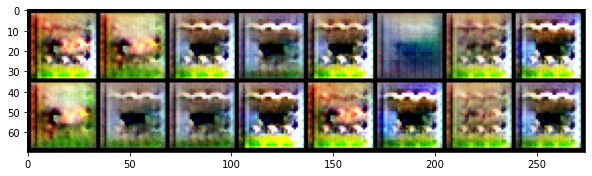

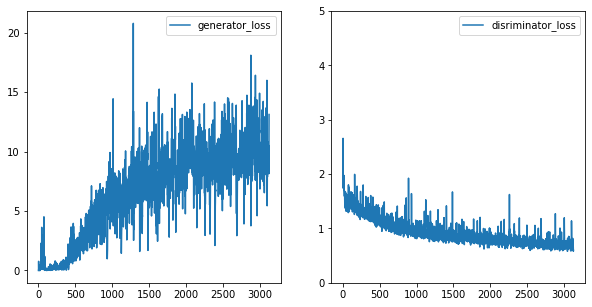


Test set: Average loss: 1.7286, Accuracy: 2141/5000 (43%)


Test set: Average loss: 1.8868, Accuracy: 3903/10000 (39%)

ETA of completion: 760.7840431928635 minutes: curr_epoch 1


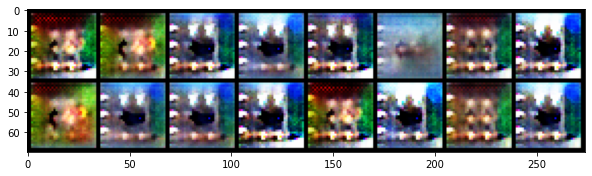

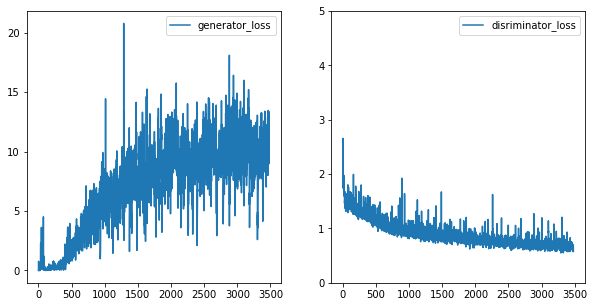


Test set: Average loss: 1.5736, Accuracy: 2313/5000 (46%)


Test set: Average loss: 1.7197, Accuracy: 4232/10000 (42%)

ETA of completion: 760.6753656784693 minutes: curr_epoch 2


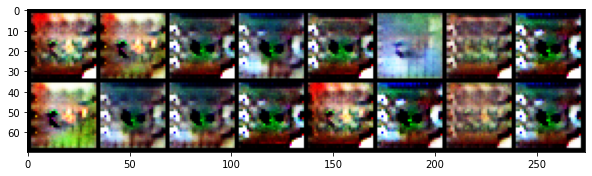

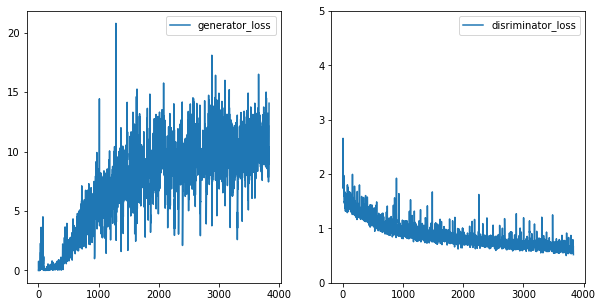


Test set: Average loss: 1.8026, Accuracy: 2122/5000 (42%)


Test set: Average loss: 1.9908, Accuracy: 3836/10000 (38%)

ETA of completion: 757.2103286266326 minutes: curr_epoch 3


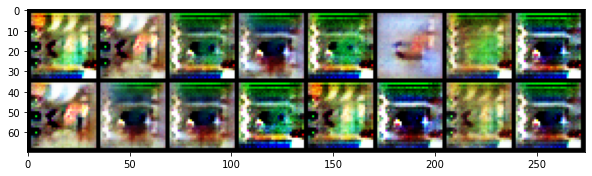

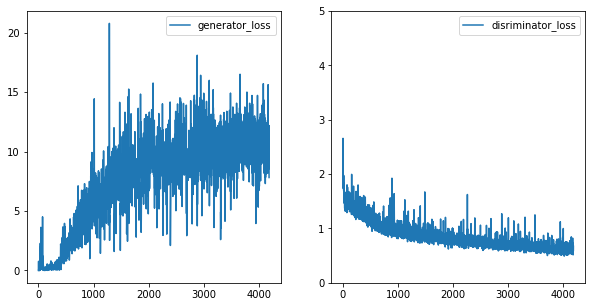


Test set: Average loss: 1.5641, Accuracy: 2347/5000 (47%)


Test set: Average loss: 1.7962, Accuracy: 4204/10000 (42%)

ETA of completion: 758.2749898751576 minutes: curr_epoch 4


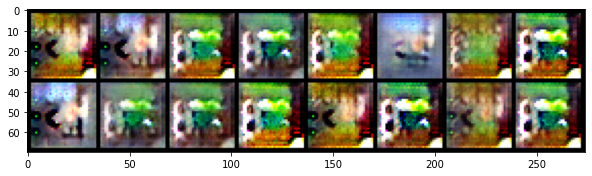

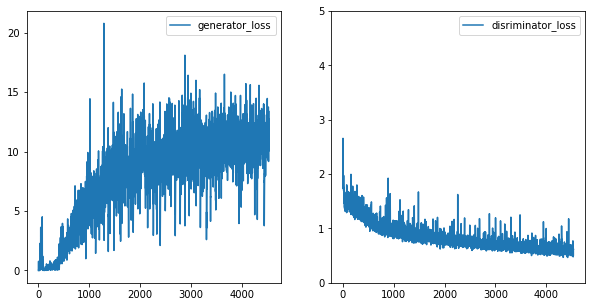


Test set: Average loss: 1.8564, Accuracy: 2090/5000 (42%)


Test set: Average loss: 1.9864, Accuracy: 3865/10000 (39%)

ETA of completion: 755.2752206722895 minutes: curr_epoch 5


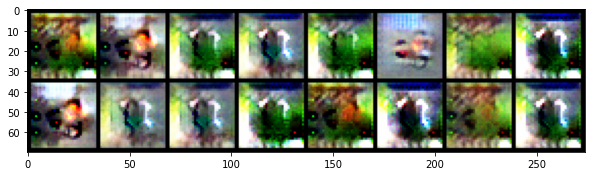

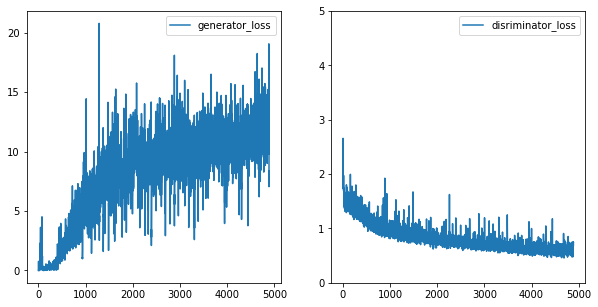


Test set: Average loss: 1.9922, Accuracy: 2149/5000 (43%)


Test set: Average loss: 2.2300, Accuracy: 3829/10000 (38%)

ETA of completion: 754.9870408058166 minutes: curr_epoch 6


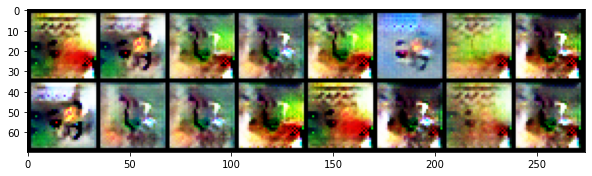

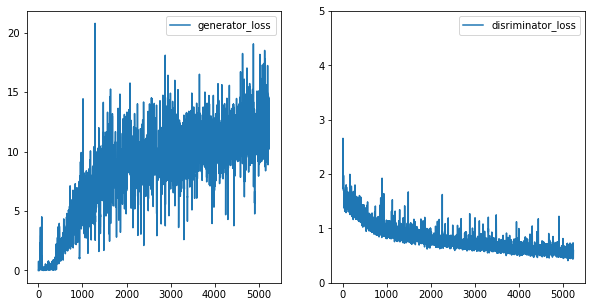


Test set: Average loss: 1.4162, Accuracy: 2607/5000 (52%)


Test set: Average loss: 1.7270, Accuracy: 4561/10000 (46%)

ETA of completion: 755.5088301976522 minutes: curr_epoch 7


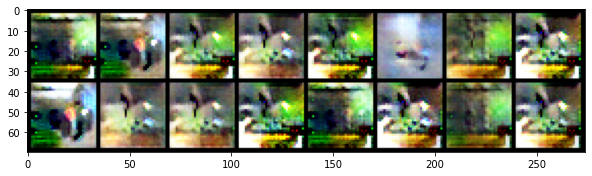

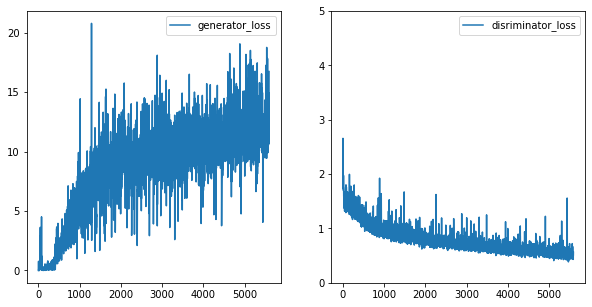


Test set: Average loss: 1.1328, Accuracy: 2991/5000 (60%)


Test set: Average loss: 1.4778, Accuracy: 5033/10000 (50%)

ETA of completion: 753.973812421163 minutes: curr_epoch 8


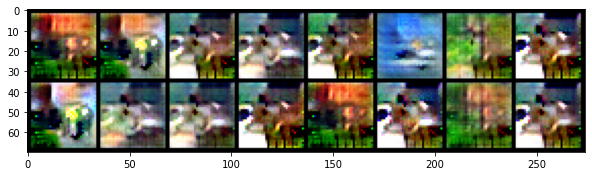

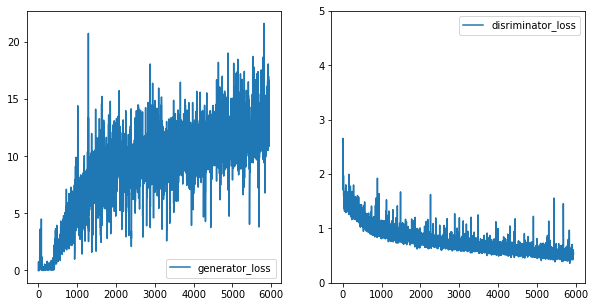


Test set: Average loss: 1.5111, Accuracy: 2563/5000 (51%)


Test set: Average loss: 1.8670, Accuracy: 4425/10000 (44%)

ETA of completion: 748.2553477883339 minutes: curr_epoch 9


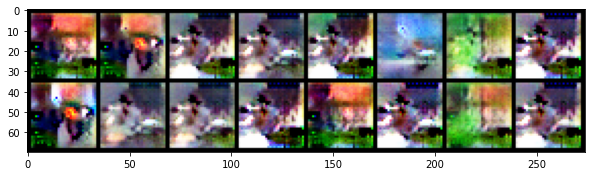

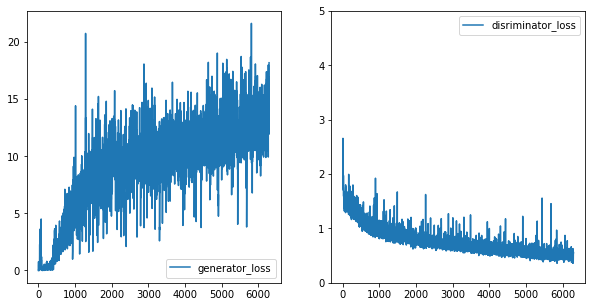


Test set: Average loss: 1.2979, Accuracy: 2844/5000 (57%)


Test set: Average loss: 1.7002, Accuracy: 4713/10000 (47%)

ETA of completion: 748.0197505950928 minutes: curr_epoch 10


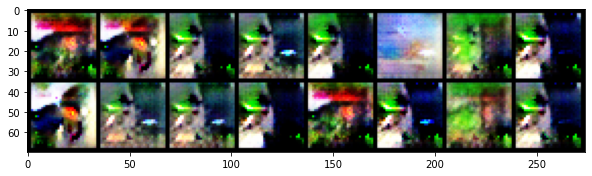

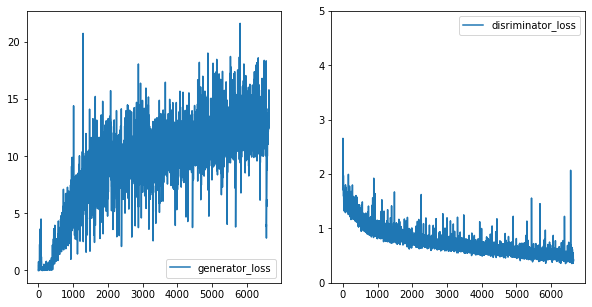


Test set: Average loss: 1.0586, Accuracy: 3123/5000 (62%)


Test set: Average loss: 1.4527, Accuracy: 5164/10000 (52%)

ETA of completion: 748.7165509343147 minutes: curr_epoch 11


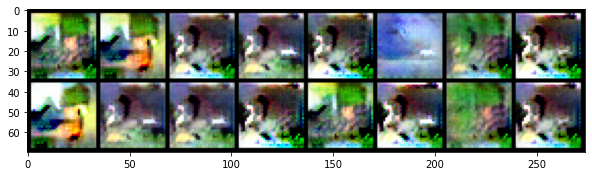

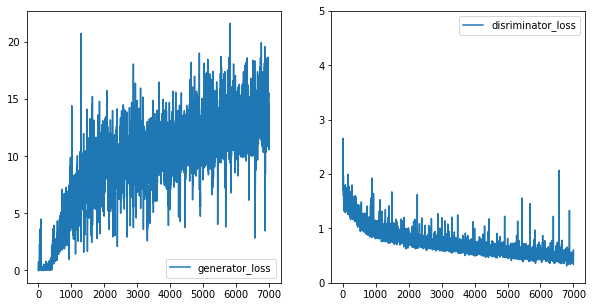


Test set: Average loss: 1.1469, Accuracy: 3070/5000 (61%)


Test set: Average loss: 1.5694, Accuracy: 5022/10000 (50%)

ETA of completion: 747.3674232482911 minutes: curr_epoch 12


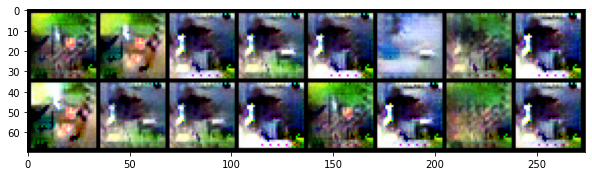

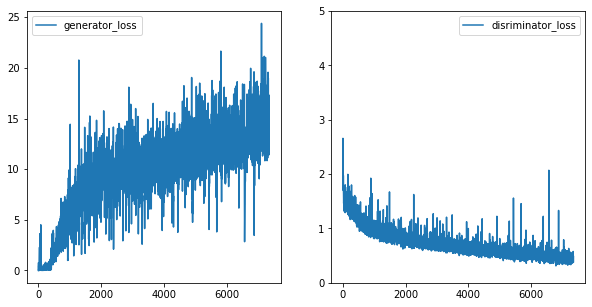


Test set: Average loss: 1.2746, Accuracy: 2872/5000 (57%)


Test set: Average loss: 1.7800, Accuracy: 4647/10000 (46%)

ETA of completion: 740.6255614042282 minutes: curr_epoch 13


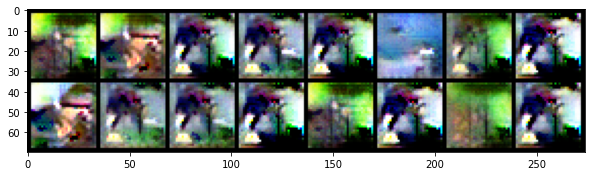

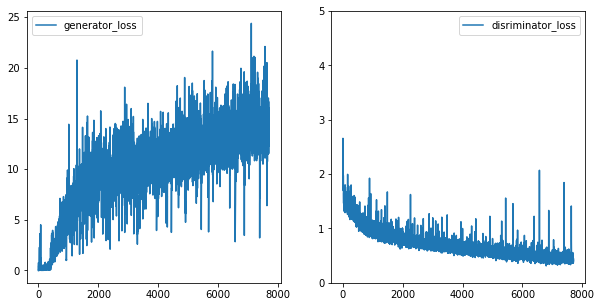


Test set: Average loss: 1.2096, Accuracy: 2937/5000 (59%)


Test set: Average loss: 1.7629, Accuracy: 4864/10000 (49%)

ETA of completion: 748.6398256540299 minutes: curr_epoch 14


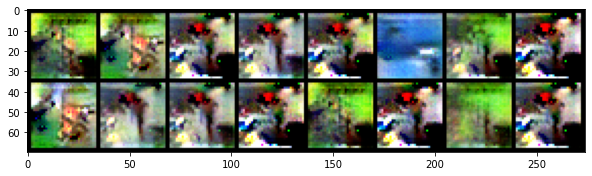

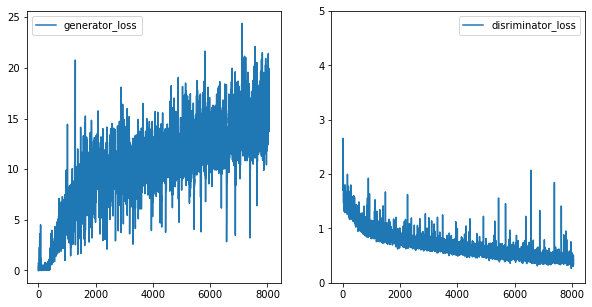


Test set: Average loss: 1.1076, Accuracy: 3101/5000 (62%)


Test set: Average loss: 1.6162, Accuracy: 4906/10000 (49%)

ETA of completion: 741.0262956619263 minutes: curr_epoch 15


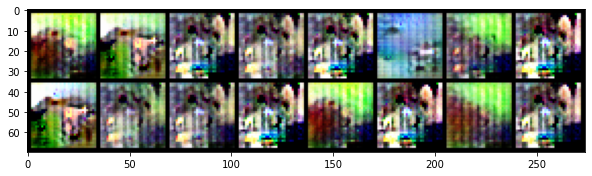

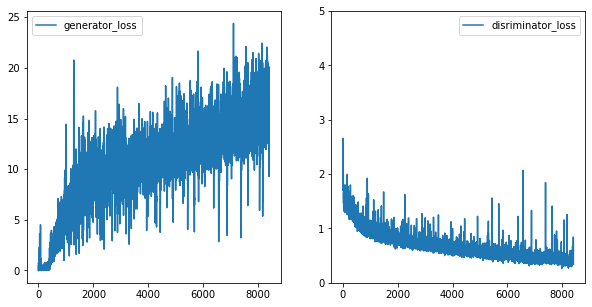


Test set: Average loss: 1.0046, Accuracy: 3264/5000 (65%)


Test set: Average loss: 1.6004, Accuracy: 5134/10000 (51%)

ETA of completion: 741.5817621866862 minutes: curr_epoch 16


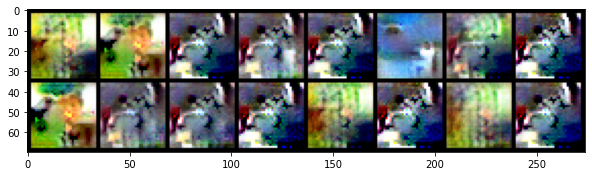

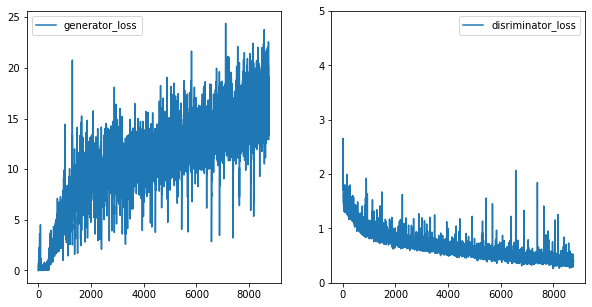


Test set: Average loss: 1.0038, Accuracy: 3251/5000 (65%)


Test set: Average loss: 1.5905, Accuracy: 5222/10000 (52%)

ETA of completion: 739.9593595782916 minutes: curr_epoch 17


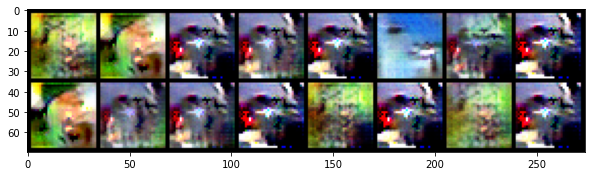

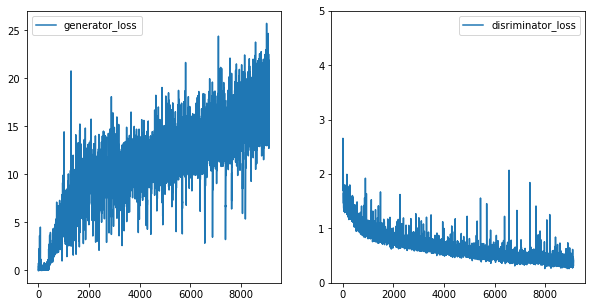


Test set: Average loss: 1.3363, Accuracy: 2906/5000 (58%)


Test set: Average loss: 1.8792, Accuracy: 4710/10000 (47%)

ETA of completion: 742.0571599960327 minutes: curr_epoch 18


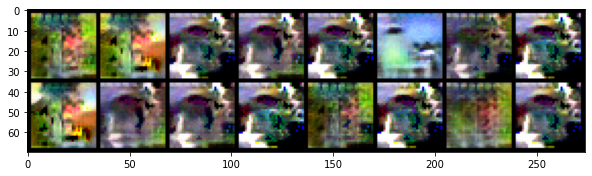

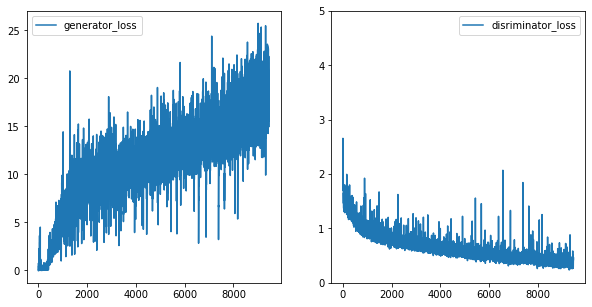


Test set: Average loss: 1.0802, Accuracy: 3178/5000 (64%)


Test set: Average loss: 1.7152, Accuracy: 5052/10000 (51%)

ETA of completion: 738.850388832887 minutes: curr_epoch 19


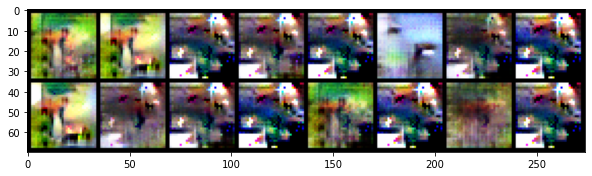

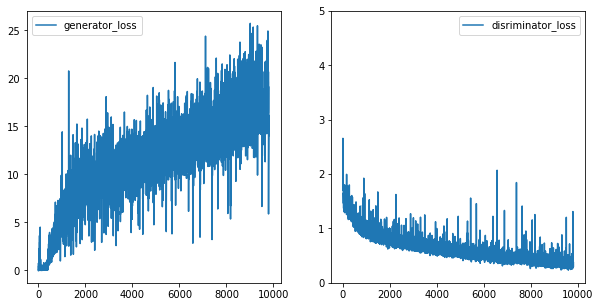


Test set: Average loss: 0.9756, Accuracy: 3298/5000 (66%)


Test set: Average loss: 1.6904, Accuracy: 5109/10000 (51%)

ETA of completion: 735.4988132317861 minutes: curr_epoch 20


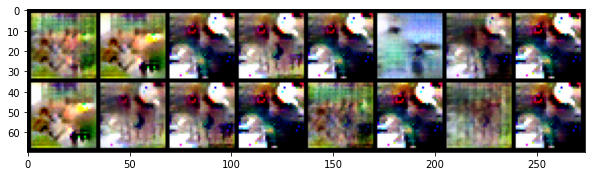

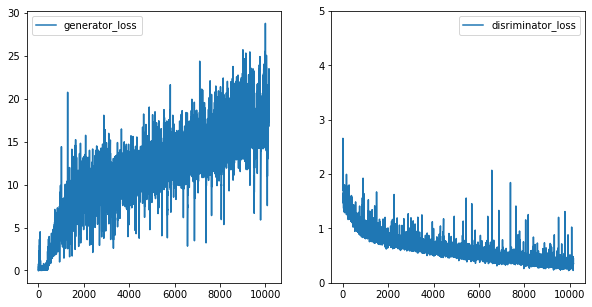


Test set: Average loss: 1.1580, Accuracy: 3183/5000 (64%)


Test set: Average loss: 1.8779, Accuracy: 4918/10000 (49%)

ETA of completion: 729.5434041738511 minutes: curr_epoch 21


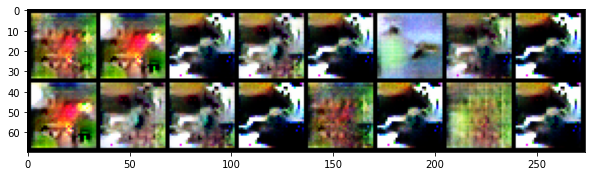

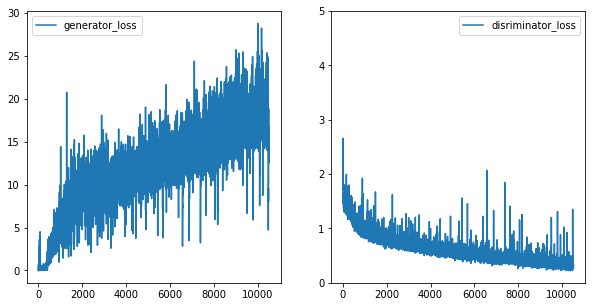


Test set: Average loss: 0.8130, Accuracy: 3558/5000 (71%)


Test set: Average loss: 1.5806, Accuracy: 5382/10000 (54%)

ETA of completion: 729.028868707021 minutes: curr_epoch 22


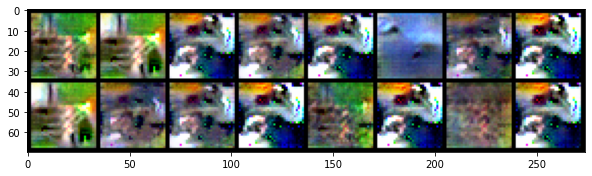

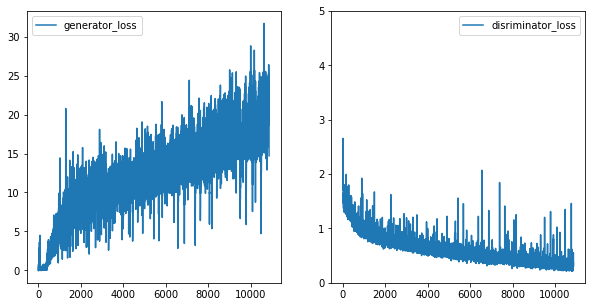


Test set: Average loss: 0.8973, Accuracy: 3526/5000 (71%)


Test set: Average loss: 1.7302, Accuracy: 5273/10000 (53%)

ETA of completion: 734.4754410306613 minutes: curr_epoch 23


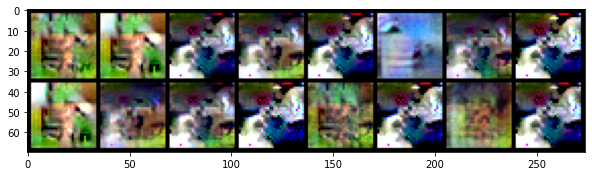

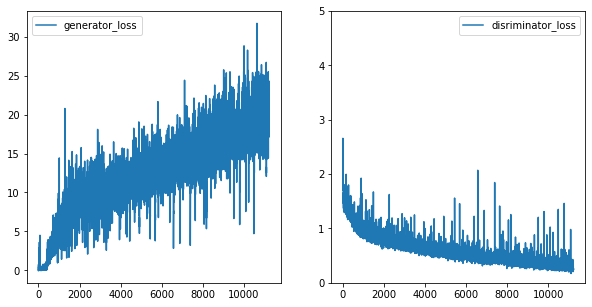


Test set: Average loss: 1.0398, Accuracy: 3283/5000 (66%)


Test set: Average loss: 1.8886, Accuracy: 4959/10000 (50%)

ETA of completion: 735.1154846191406 minutes: curr_epoch 24


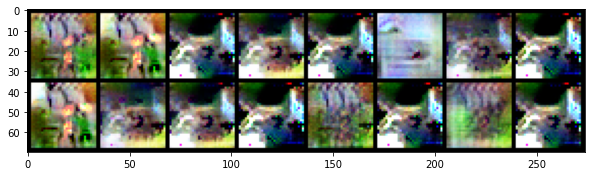

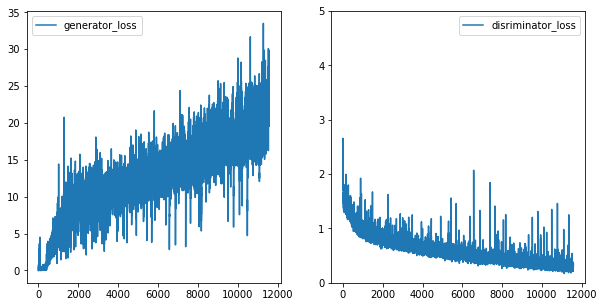


Test set: Average loss: 0.9519, Accuracy: 3397/5000 (68%)


Test set: Average loss: 1.8717, Accuracy: 5060/10000 (51%)

ETA of completion: 733.696908056736 minutes: curr_epoch 25


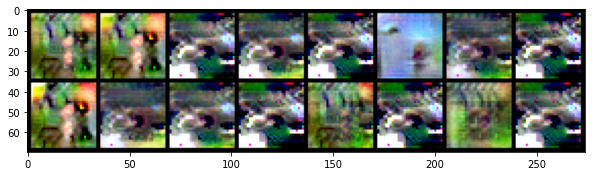

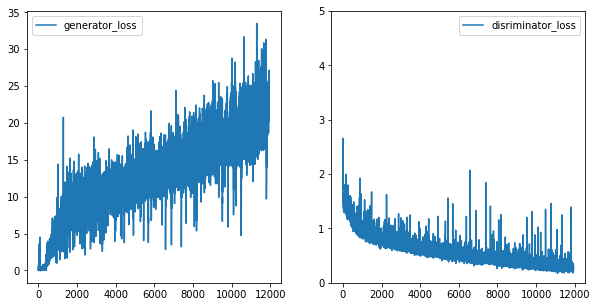


Test set: Average loss: 0.9284, Accuracy: 3469/5000 (69%)


Test set: Average loss: 1.8989, Accuracy: 5104/10000 (51%)

ETA of completion: 743.474603120486 minutes: curr_epoch 26


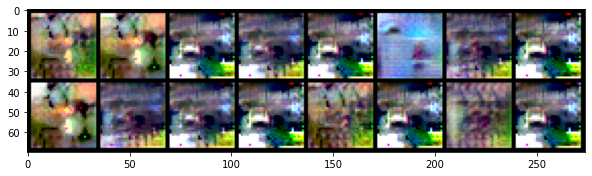

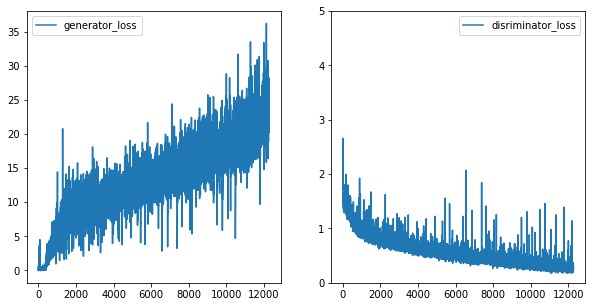


Test set: Average loss: 0.9949, Accuracy: 3375/5000 (68%)


Test set: Average loss: 1.9814, Accuracy: 5090/10000 (51%)

ETA of completion: 729.9821414470673 minutes: curr_epoch 27


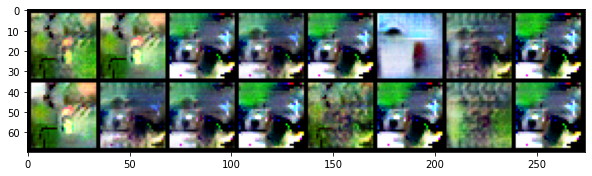

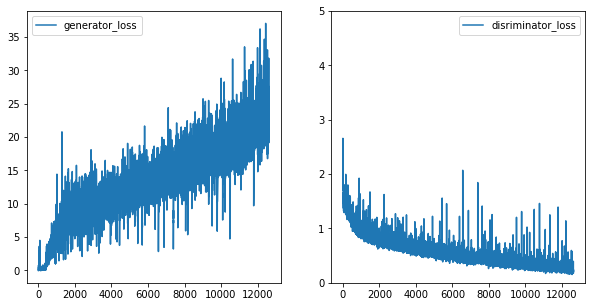


Test set: Average loss: 0.8219, Accuracy: 3639/5000 (73%)


Test set: Average loss: 1.7991, Accuracy: 5346/10000 (53%)

ETA of completion: 731.0561131954194 minutes: curr_epoch 28


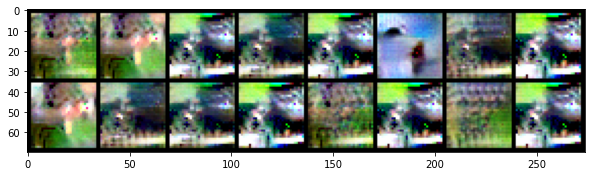

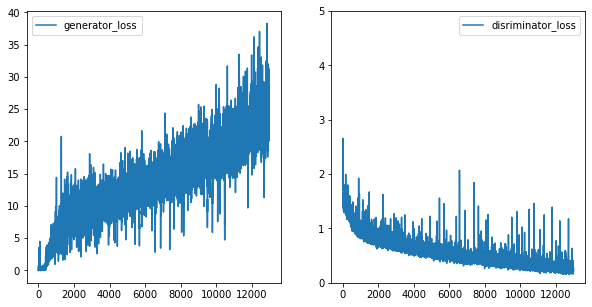


Test set: Average loss: 0.9895, Accuracy: 3429/5000 (69%)


Test set: Average loss: 2.0240, Accuracy: 5088/10000 (51%)

ETA of completion: 728.3663953145345 minutes: curr_epoch 29


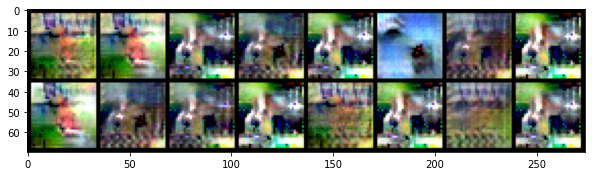

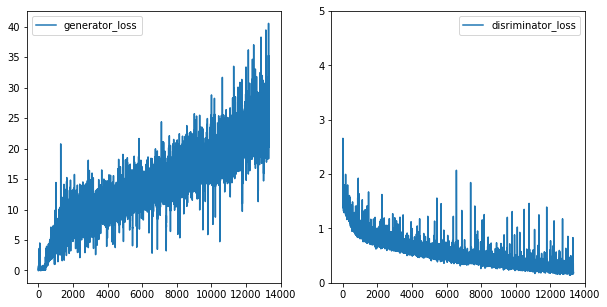


Test set: Average loss: 0.7945, Accuracy: 3706/5000 (74%)


Test set: Average loss: 1.8919, Accuracy: 5170/10000 (52%)

ETA of completion: 724.8970884084702 minutes: curr_epoch 30


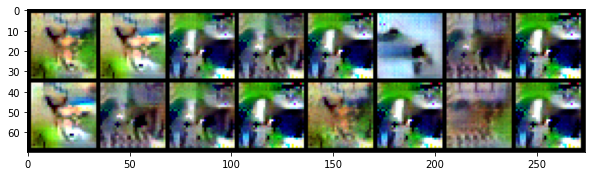

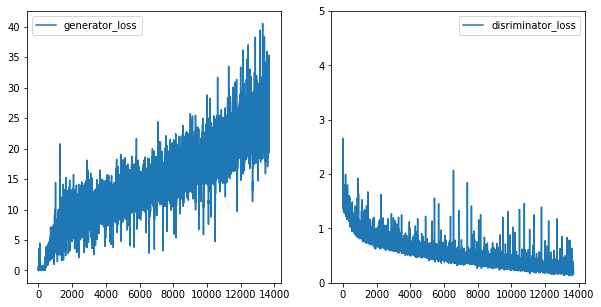


Test set: Average loss: 1.0475, Accuracy: 3375/5000 (68%)


Test set: Average loss: 2.1334, Accuracy: 4925/10000 (49%)

ETA of completion: 722.0350378990173 minutes: curr_epoch 31


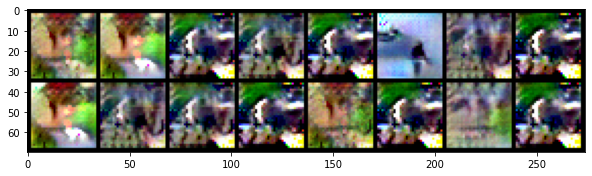

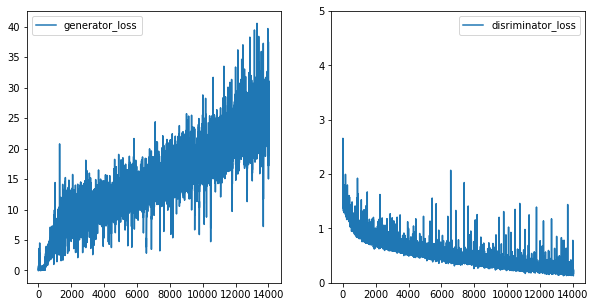


Test set: Average loss: 0.9875, Accuracy: 3464/5000 (69%)


Test set: Average loss: 2.0909, Accuracy: 5057/10000 (51%)

ETA of completion: 718.5035313606262 minutes: curr_epoch 32


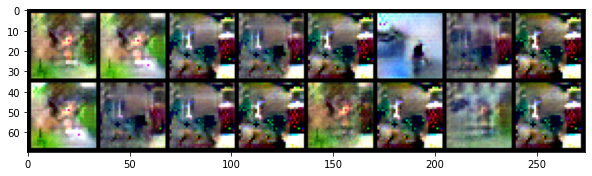

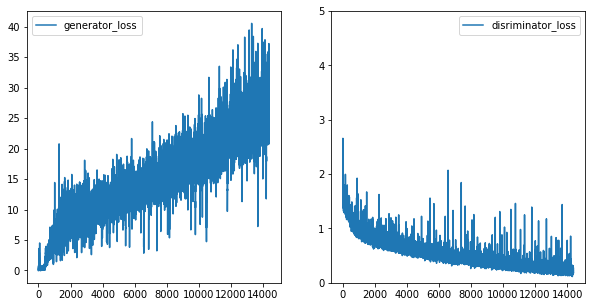


Test set: Average loss: 0.7031, Accuracy: 3790/5000 (76%)


Test set: Average loss: 1.7209, Accuracy: 5363/10000 (54%)

ETA of completion: 717.4898120999336 minutes: curr_epoch 33


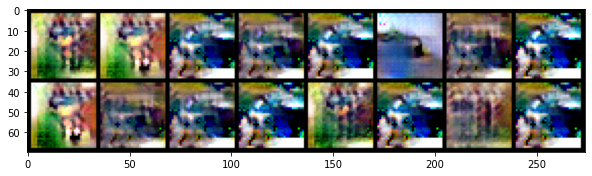

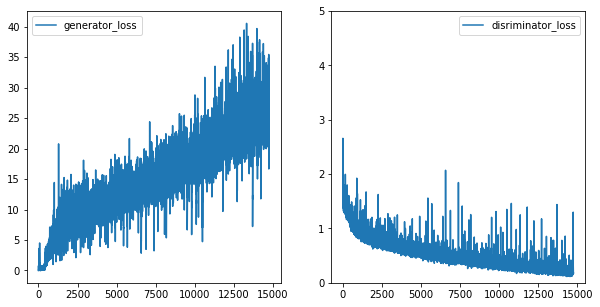


Test set: Average loss: 0.8422, Accuracy: 3559/5000 (71%)


Test set: Average loss: 1.8203, Accuracy: 5182/10000 (52%)

ETA of completion: 727.1523699442546 minutes: curr_epoch 34


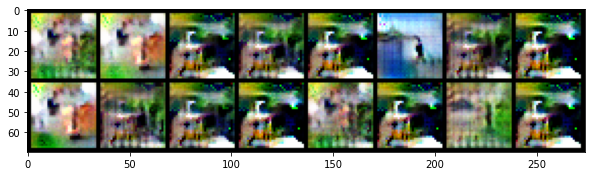

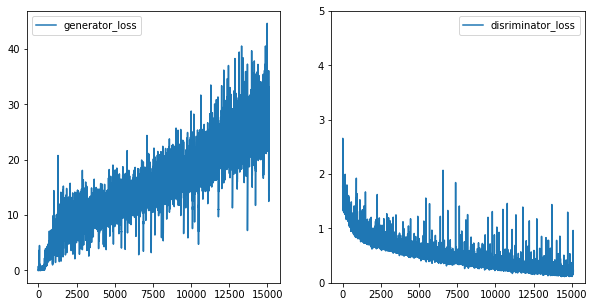


Test set: Average loss: 0.8846, Accuracy: 3644/5000 (73%)


Test set: Average loss: 2.1498, Accuracy: 5223/10000 (52%)

ETA of completion: 723.3878567417463 minutes: curr_epoch 35


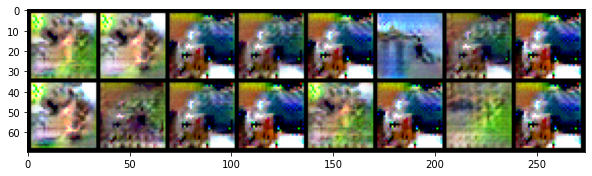

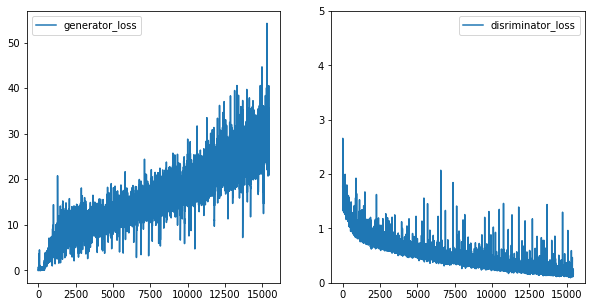


Test set: Average loss: 0.8211, Accuracy: 3648/5000 (73%)


Test set: Average loss: 1.8748, Accuracy: 5283/10000 (53%)

ETA of completion: 715.8185441017151 minutes: curr_epoch 36


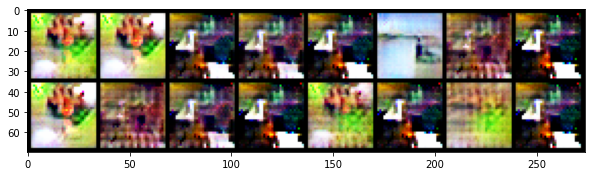

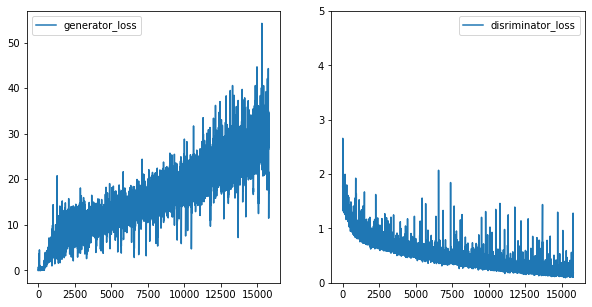


Test set: Average loss: 0.9251, Accuracy: 3614/5000 (72%)


Test set: Average loss: 2.1919, Accuracy: 5179/10000 (52%)

ETA of completion: 714.8903839230537 minutes: curr_epoch 37


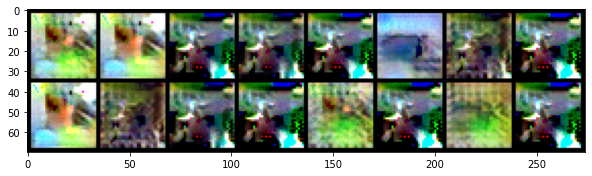

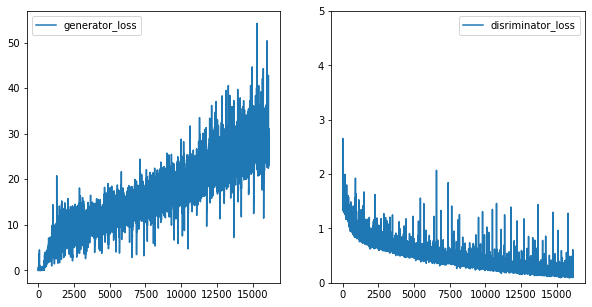


Test set: Average loss: 0.7775, Accuracy: 3779/5000 (76%)


Test set: Average loss: 2.0207, Accuracy: 5298/10000 (53%)

ETA of completion: 710.8434916814168 minutes: curr_epoch 38


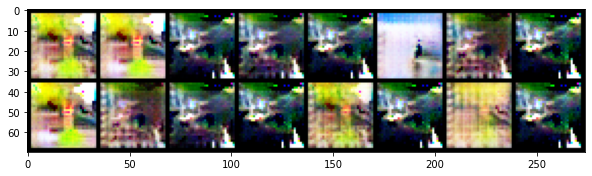

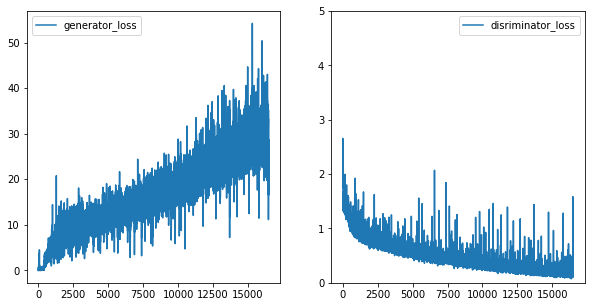


Test set: Average loss: 1.0572, Accuracy: 3440/5000 (69%)


Test set: Average loss: 2.3183, Accuracy: 4945/10000 (49%)

ETA of completion: 706.4850453615188 minutes: curr_epoch 39


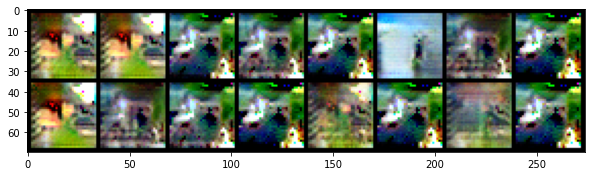

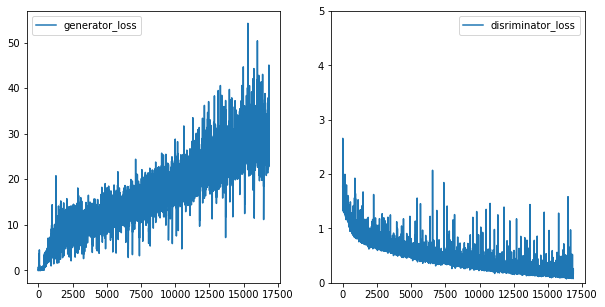


Test set: Average loss: 1.2800, Accuracy: 3246/5000 (65%)


Test set: Average loss: 2.6684, Accuracy: 4797/10000 (48%)

ETA of completion: 705.697566986084 minutes: curr_epoch 40


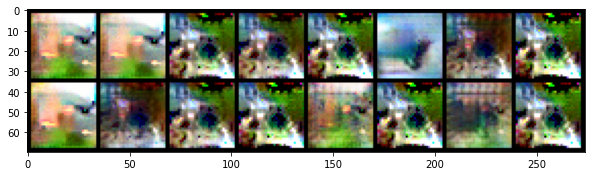

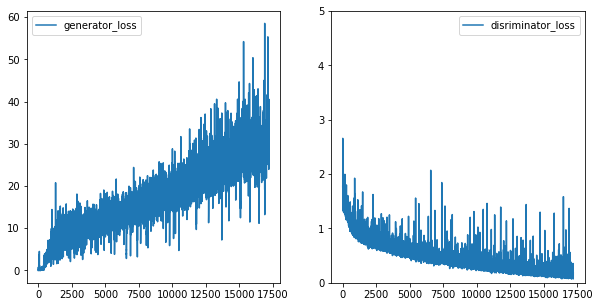


Test set: Average loss: 1.3086, Accuracy: 3215/5000 (64%)


Test set: Average loss: 2.6530, Accuracy: 4737/10000 (47%)

ETA of completion: 702.5760003685951 minutes: curr_epoch 41


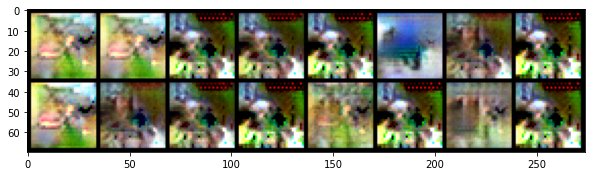

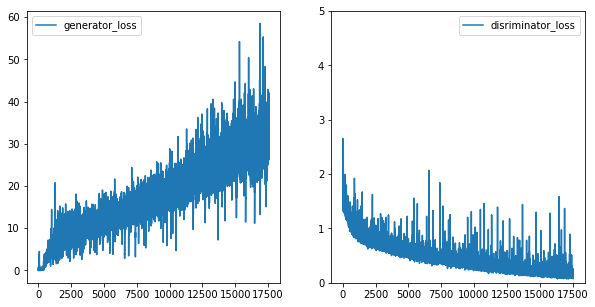


Test set: Average loss: 1.0727, Accuracy: 3479/5000 (70%)


Test set: Average loss: 2.4035, Accuracy: 5070/10000 (51%)

Epoch 00050: reducing learning rate of group 0 to 1.5000e-04.
Epoch 00050: reducing learning rate of group 0 to 1.5000e-04.
ETA of completion: 702.0753149271011 minutes: curr_epoch 42


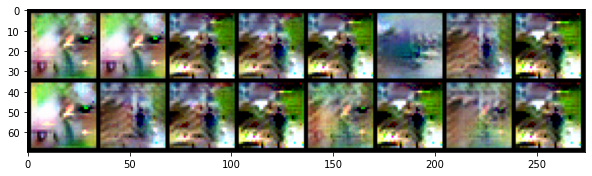

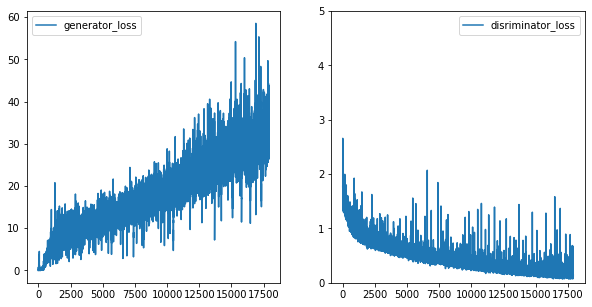


Test set: Average loss: 0.8664, Accuracy: 3804/5000 (76%)


Test set: Average loss: 2.5991, Accuracy: 5343/10000 (53%)

ETA of completion: 698.9010251363119 minutes: curr_epoch 43


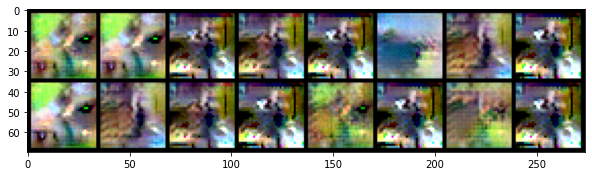

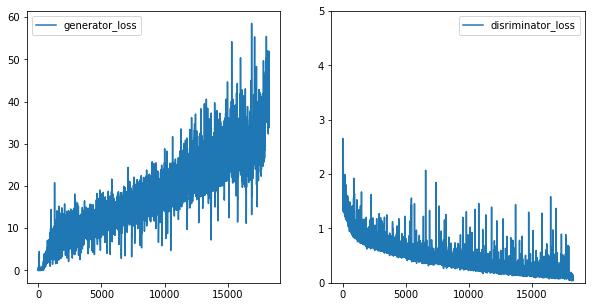


Test set: Average loss: 0.7576, Accuracy: 3932/5000 (79%)


Test set: Average loss: 2.6410, Accuracy: 5384/10000 (54%)

ETA of completion: 704.4044591267904 minutes: curr_epoch 44


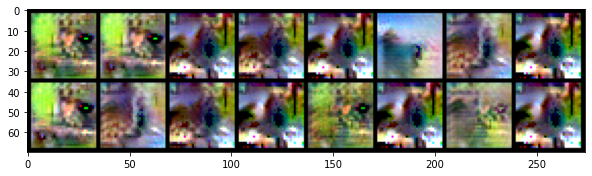

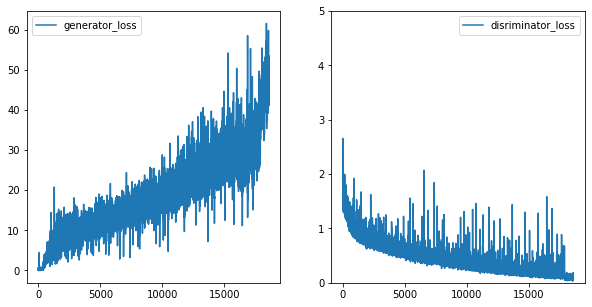


Test set: Average loss: 1.0113, Accuracy: 3760/5000 (75%)


Test set: Average loss: 2.9309, Accuracy: 5236/10000 (52%)

ETA of completion: 698.3582457900047 minutes: curr_epoch 45


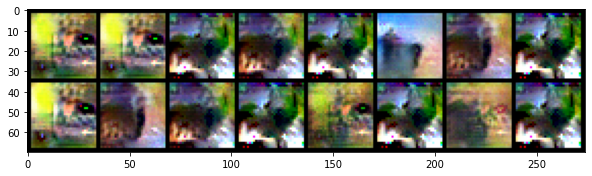

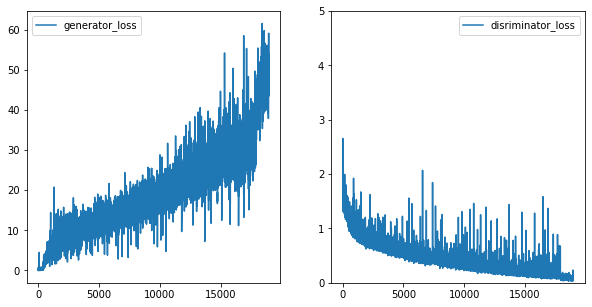


Test set: Average loss: 0.9648, Accuracy: 3812/5000 (76%)


Test set: Average loss: 2.8824, Accuracy: 5266/10000 (53%)

ETA of completion: 697.6635798374812 minutes: curr_epoch 46


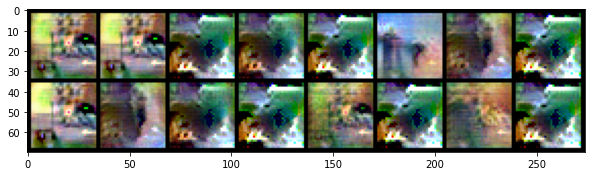

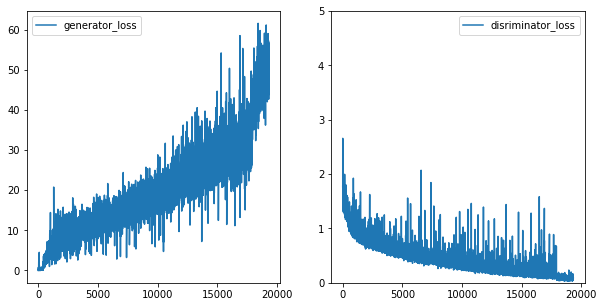


Test set: Average loss: 0.9333, Accuracy: 3801/5000 (76%)


Test set: Average loss: 2.9052, Accuracy: 5356/10000 (54%)

ETA of completion: 695.4554575125377 minutes: curr_epoch 47


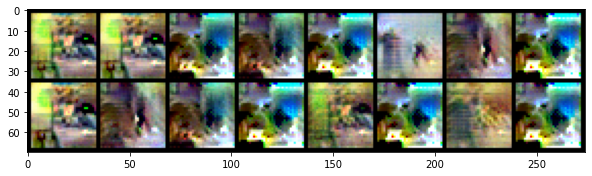

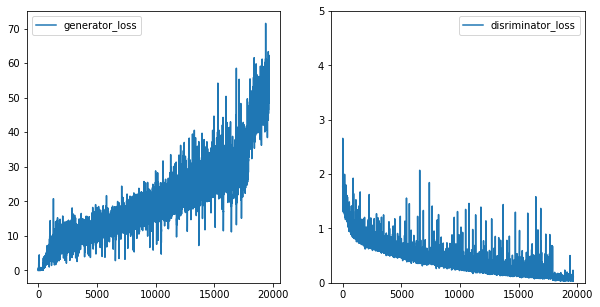


Test set: Average loss: 0.9622, Accuracy: 3793/5000 (76%)


Test set: Average loss: 2.9053, Accuracy: 5298/10000 (53%)

ETA of completion: 694.4741485595703 minutes: curr_epoch 48


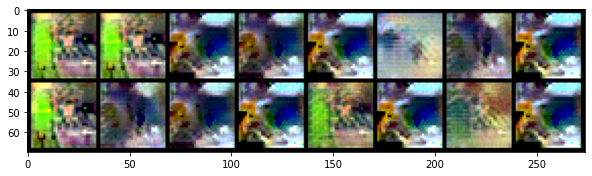

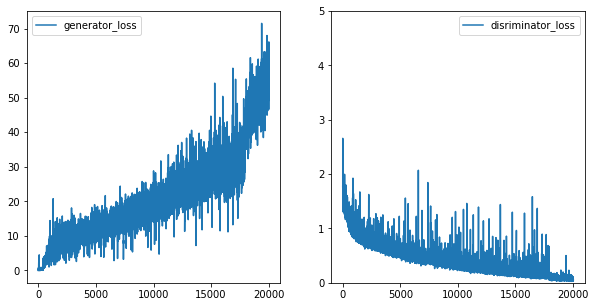


Test set: Average loss: 1.1508, Accuracy: 3593/5000 (72%)


Test set: Average loss: 3.1357, Accuracy: 5180/10000 (52%)

ETA of completion: 698.9657353679339 minutes: curr_epoch 49


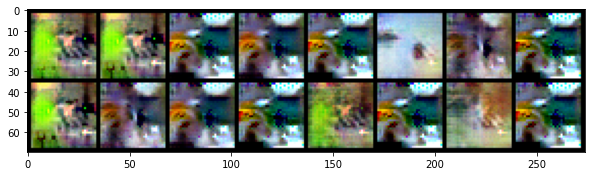

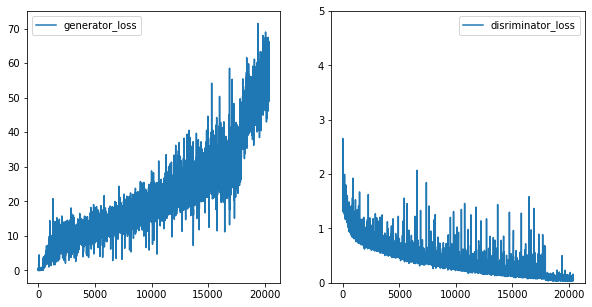


Test set: Average loss: 0.9167, Accuracy: 3828/5000 (77%)


Test set: Average loss: 2.9124, Accuracy: 5357/10000 (54%)

ETA of completion: 698.205796678861 minutes: curr_epoch 50


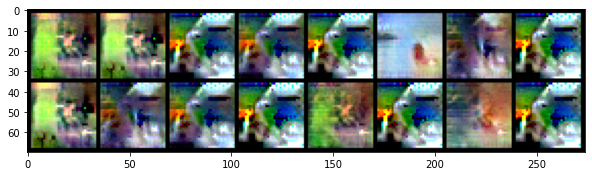

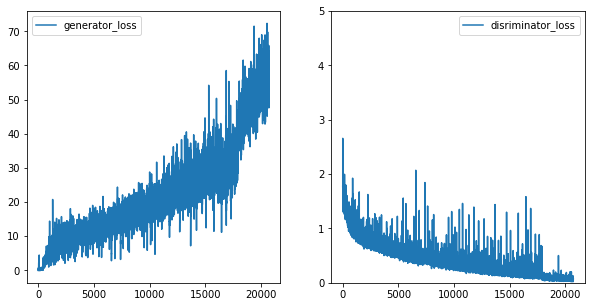


Test set: Average loss: 0.9741, Accuracy: 3751/5000 (75%)


Test set: Average loss: 3.0345, Accuracy: 5276/10000 (53%)

ETA of completion: 693.5988873839378 minutes: curr_epoch 51


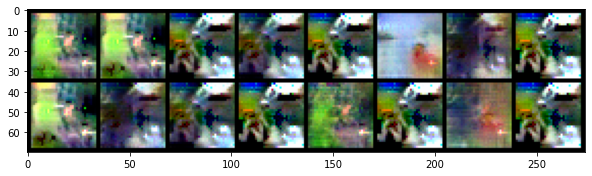

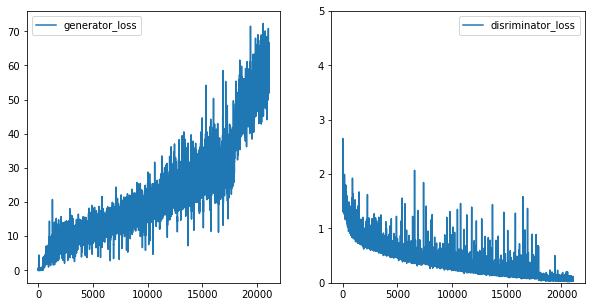


Test set: Average loss: 1.3405, Accuracy: 3523/5000 (70%)


Test set: Average loss: 3.3392, Accuracy: 5098/10000 (51%)

ETA of completion: 693.5908082326254 minutes: curr_epoch 52


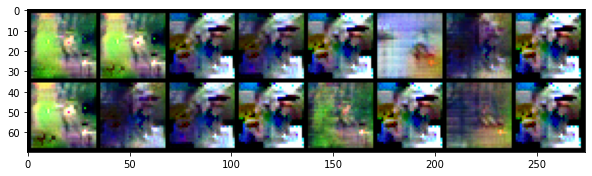

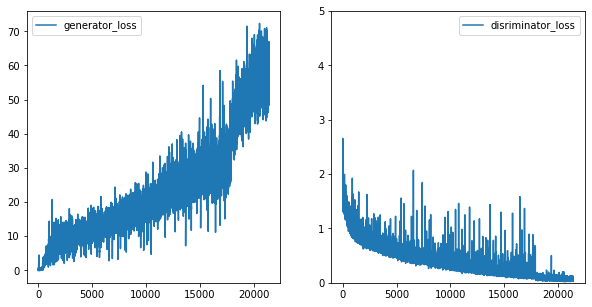


Test set: Average loss: 0.9544, Accuracy: 3770/5000 (75%)


Test set: Average loss: 3.1046, Accuracy: 5245/10000 (52%)

ETA of completion: 690.2780513763428 minutes: curr_epoch 53


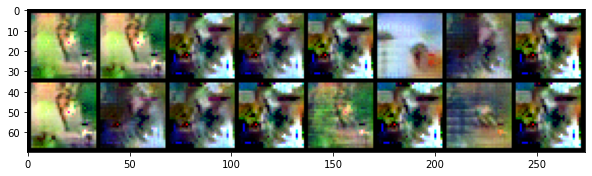

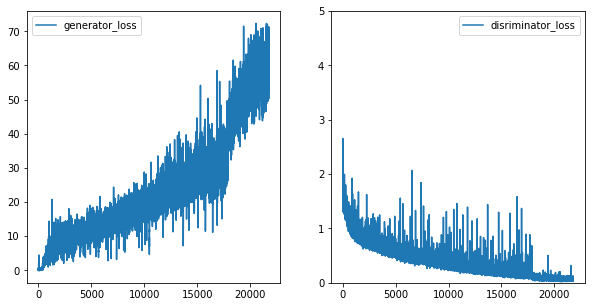


Test set: Average loss: 0.8628, Accuracy: 3867/5000 (77%)


Test set: Average loss: 3.0357, Accuracy: 5237/10000 (52%)

ETA of completion: 686.7682068347931 minutes: curr_epoch 54


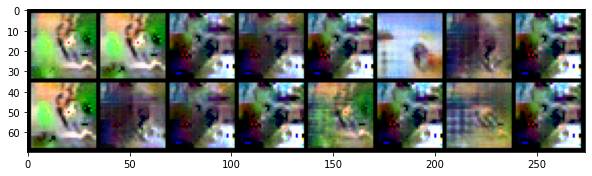

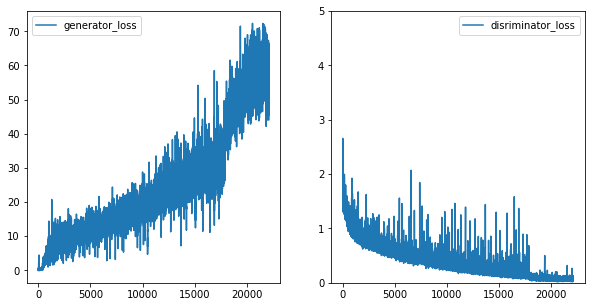


Test set: Average loss: 0.9430, Accuracy: 3802/5000 (76%)


Test set: Average loss: 3.0207, Accuracy: 5222/10000 (52%)

ETA of completion: 689.3483287096024 minutes: curr_epoch 55


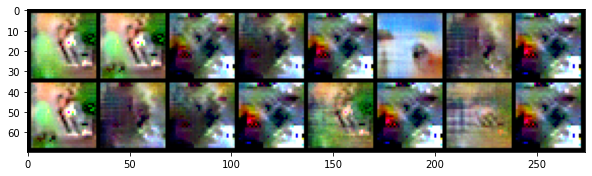

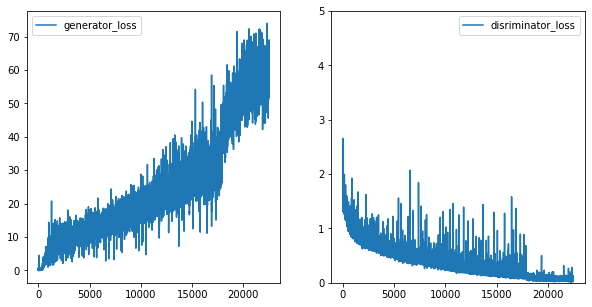


Test set: Average loss: 0.9210, Accuracy: 3828/5000 (77%)


Test set: Average loss: 3.0223, Accuracy: 5267/10000 (53%)

ETA of completion: 688.4917640686035 minutes: curr_epoch 56


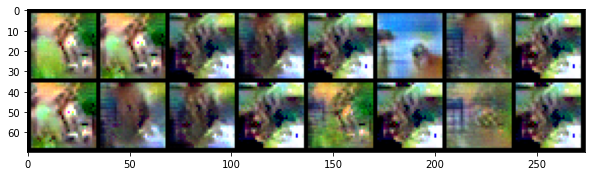

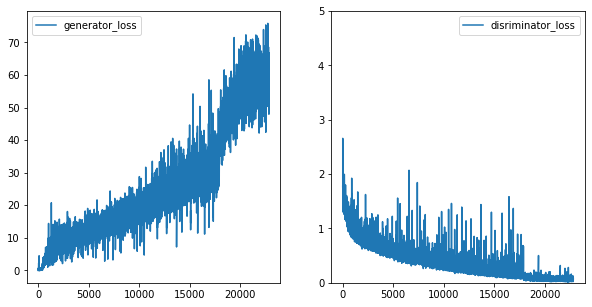


Test set: Average loss: 1.0051, Accuracy: 3749/5000 (75%)


Test set: Average loss: 3.0837, Accuracy: 5258/10000 (53%)

ETA of completion: 690.1144118189811 minutes: curr_epoch 57


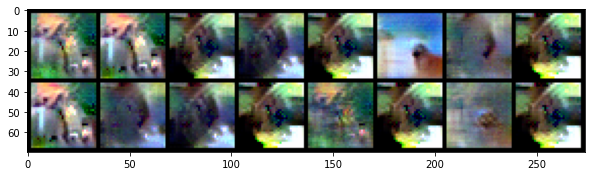

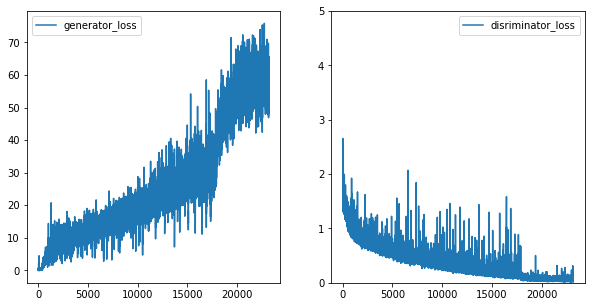


Test set: Average loss: 1.0778, Accuracy: 3737/5000 (75%)


Test set: Average loss: 3.1552, Accuracy: 5203/10000 (52%)

ETA of completion: 688.3306059281032 minutes: curr_epoch 58


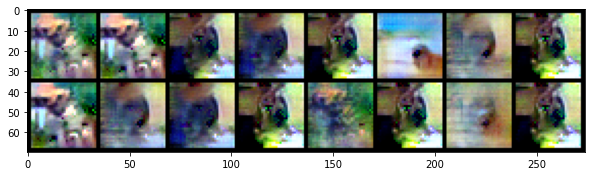

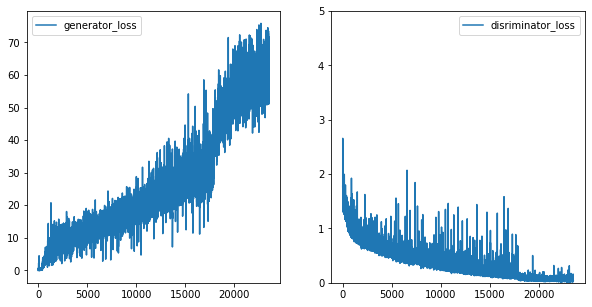


Test set: Average loss: 0.9367, Accuracy: 3911/5000 (78%)


Test set: Average loss: 3.1618, Accuracy: 5331/10000 (53%)

ETA of completion: 685.836509223779 minutes: curr_epoch 59


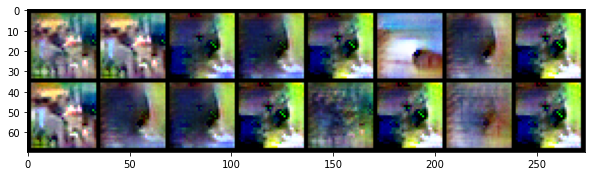

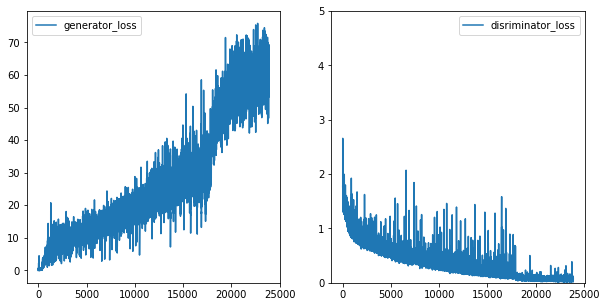


Test set: Average loss: 1.0887, Accuracy: 3707/5000 (74%)


Test set: Average loss: 3.3495, Accuracy: 5133/10000 (51%)

ETA of completion: 683.4156861305237 minutes: curr_epoch 60


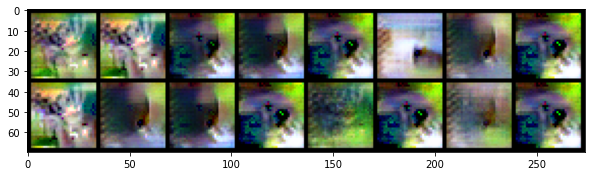

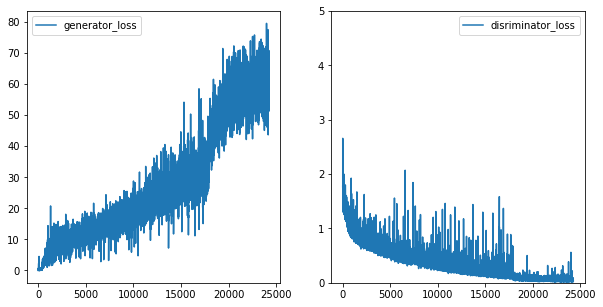


Test set: Average loss: 1.1347, Accuracy: 3684/5000 (74%)


Test set: Average loss: 3.3018, Accuracy: 5189/10000 (52%)

ETA of completion: 682.2350514849027 minutes: curr_epoch 61


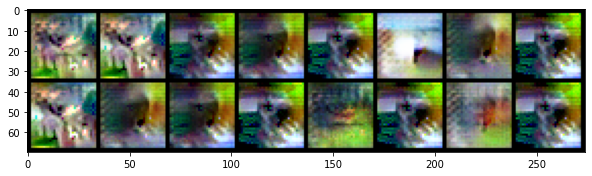

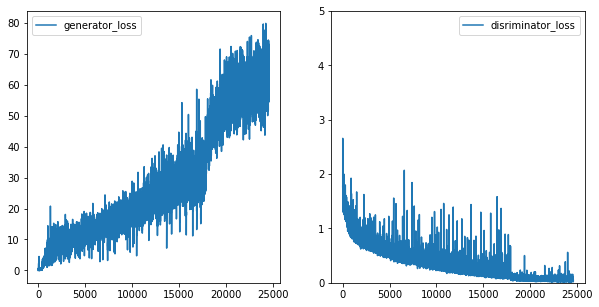


Test set: Average loss: 1.0501, Accuracy: 3743/5000 (75%)


Test set: Average loss: 3.2558, Accuracy: 5197/10000 (52%)

ETA of completion: 679.3036546707153 minutes: curr_epoch 62


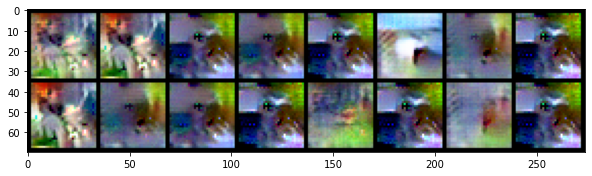

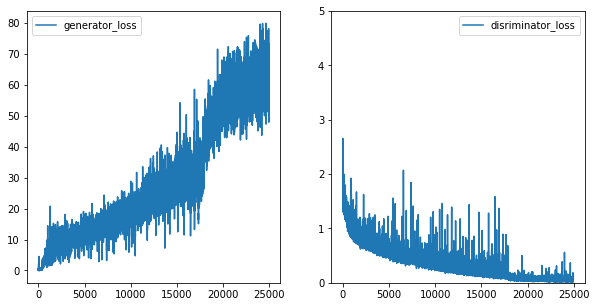


Test set: Average loss: 1.0439, Accuracy: 3764/5000 (75%)


Test set: Average loss: 3.2738, Accuracy: 5242/10000 (52%)

ETA of completion: 679.9398371934891 minutes: curr_epoch 63


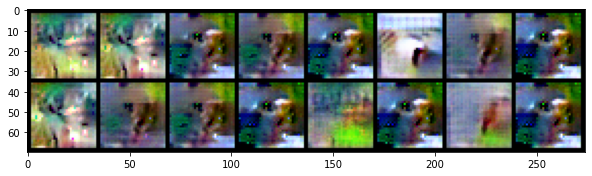

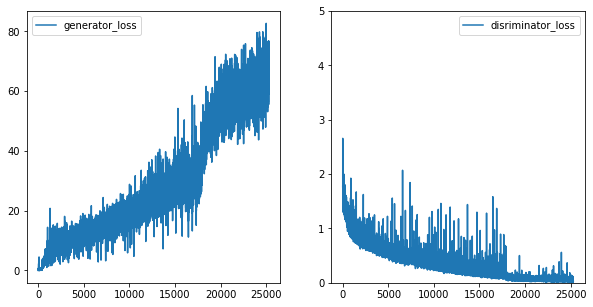


Test set: Average loss: 0.8802, Accuracy: 3928/5000 (79%)


Test set: Average loss: 3.0322, Accuracy: 5353/10000 (54%)

ETA of completion: 680.3990989049275 minutes: curr_epoch 64


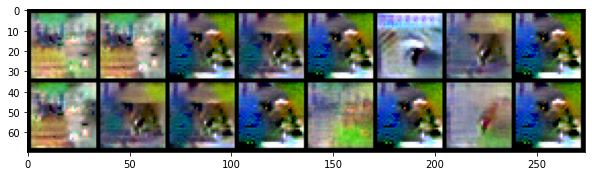

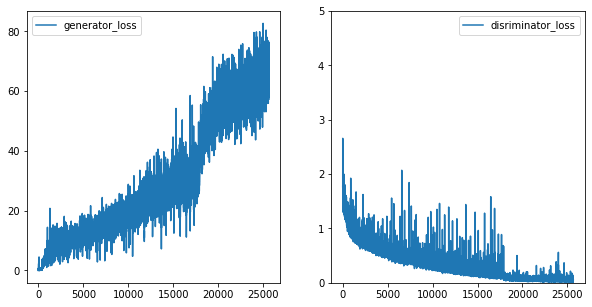


Test set: Average loss: 1.1025, Accuracy: 3719/5000 (74%)


Test set: Average loss: 3.2052, Accuracy: 5218/10000 (52%)

ETA of completion: 678.5617721875509 minutes: curr_epoch 65


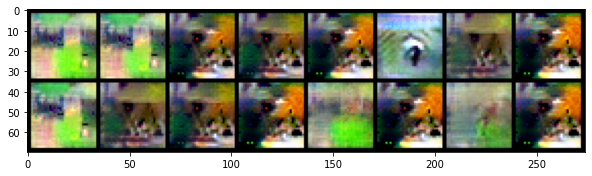

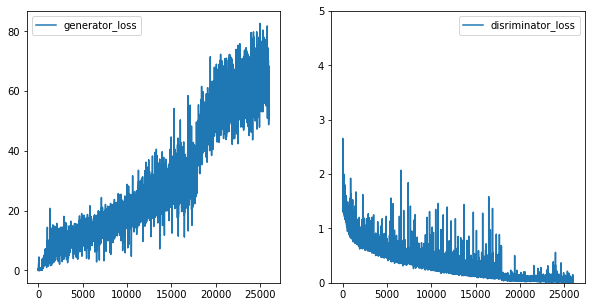


Test set: Average loss: 0.9099, Accuracy: 3896/5000 (78%)


Test set: Average loss: 3.1098, Accuracy: 5315/10000 (53%)

ETA of completion: 676.767371058464 minutes: curr_epoch 66


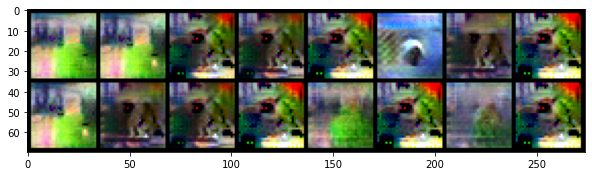

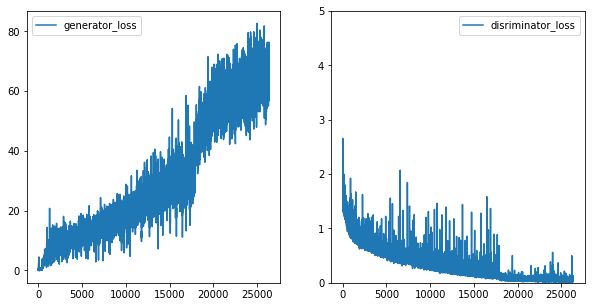


Test set: Average loss: 0.9261, Accuracy: 3894/5000 (78%)


Test set: Average loss: 3.2017, Accuracy: 5383/10000 (54%)

ETA of completion: 675.9806643923124 minutes: curr_epoch 67


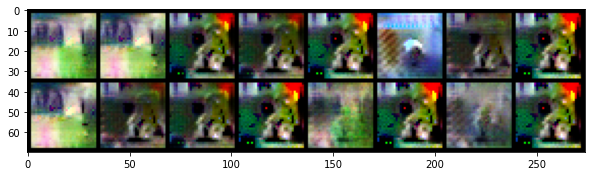

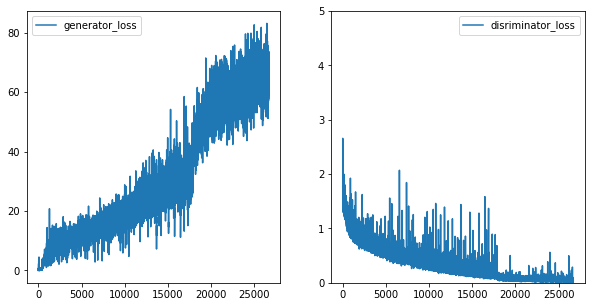


Test set: Average loss: 0.8750, Accuracy: 3916/5000 (78%)


Test set: Average loss: 3.1554, Accuracy: 5375/10000 (54%)

ETA of completion: 675.2958109696706 minutes: curr_epoch 68


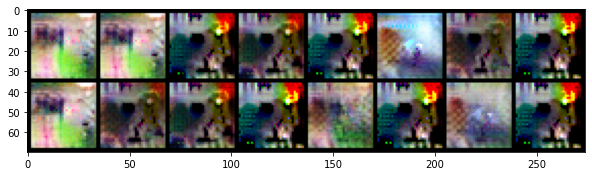

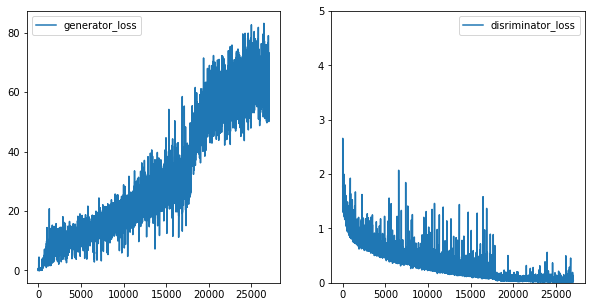


Test set: Average loss: 1.0493, Accuracy: 3824/5000 (76%)


Test set: Average loss: 3.4393, Accuracy: 5229/10000 (52%)

ETA of completion: 674.8362544298172 minutes: curr_epoch 69


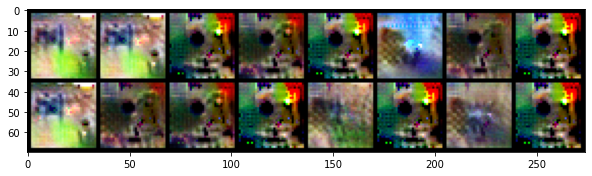

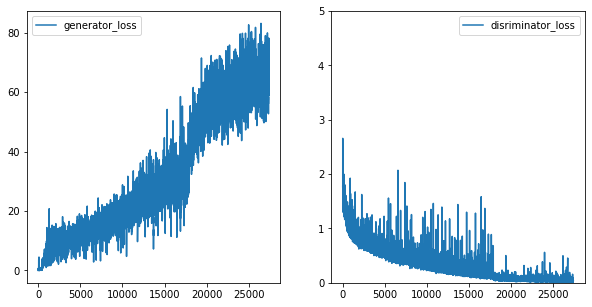


Test set: Average loss: 0.8412, Accuracy: 3959/5000 (79%)


Test set: Average loss: 3.1666, Accuracy: 5312/10000 (53%)

ETA of completion: 672.0065618753433 minutes: curr_epoch 70


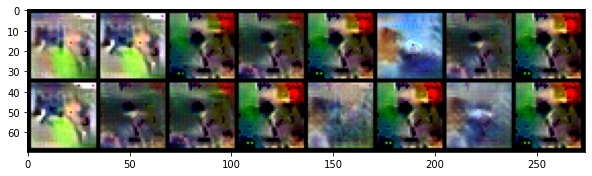

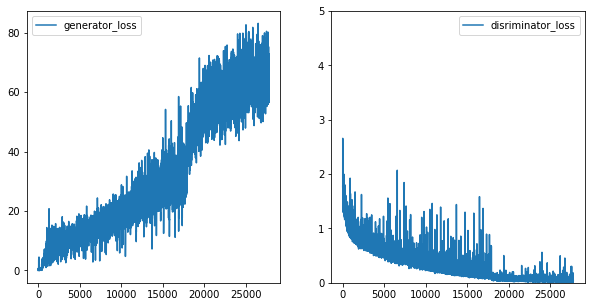


Test set: Average loss: 1.1187, Accuracy: 3785/5000 (76%)


Test set: Average loss: 3.5419, Accuracy: 5266/10000 (53%)

ETA of completion: 671.3258850773176 minutes: curr_epoch 71


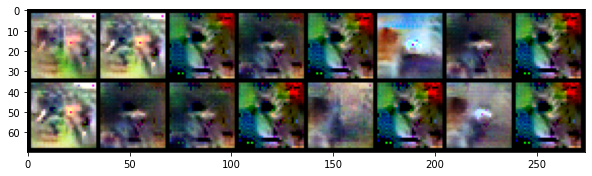

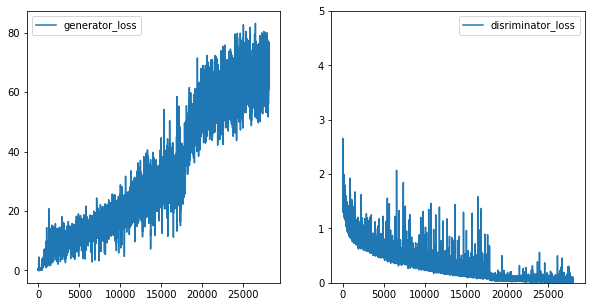


Test set: Average loss: 0.8687, Accuracy: 3912/5000 (78%)


Test set: Average loss: 3.1808, Accuracy: 5378/10000 (54%)

ETA of completion: 671.206749343872 minutes: curr_epoch 72


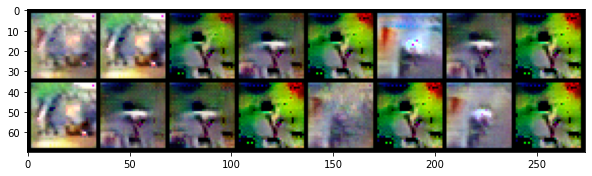

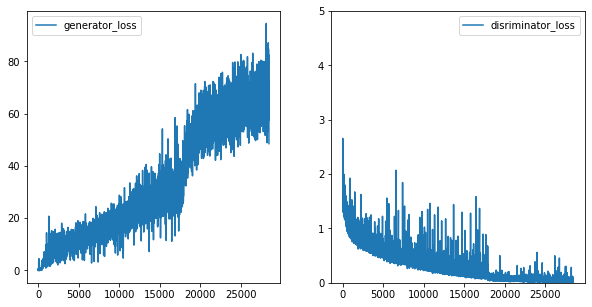


Test set: Average loss: 1.1032, Accuracy: 3757/5000 (75%)


Test set: Average loss: 3.3881, Accuracy: 5332/10000 (53%)

Epoch 00081: reducing learning rate of group 0 to 7.5000e-05.
Epoch 00081: reducing learning rate of group 0 to 7.5000e-05.
ETA of completion: 666.9327530980111 minutes: curr_epoch 73


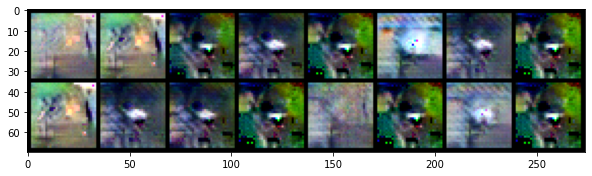

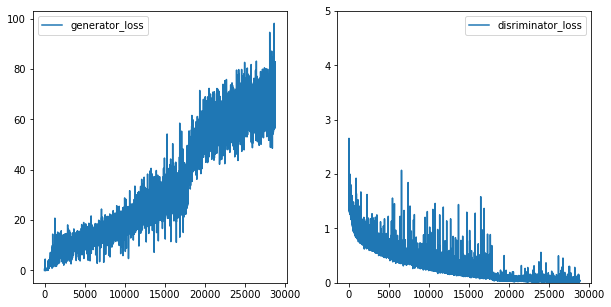


Test set: Average loss: 0.9619, Accuracy: 3946/5000 (79%)


Test set: Average loss: 3.5942, Accuracy: 5391/10000 (54%)

ETA of completion: 666.2037640174229 minutes: curr_epoch 74


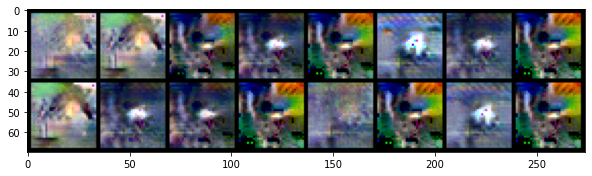

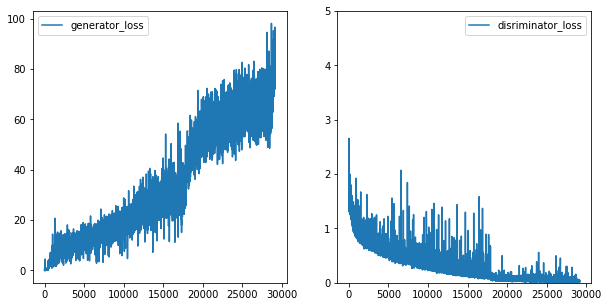


Test set: Average loss: 1.2102, Accuracy: 3736/5000 (75%)


Test set: Average loss: 3.8119, Accuracy: 5200/10000 (52%)

ETA of completion: 667.2139796614647 minutes: curr_epoch 75


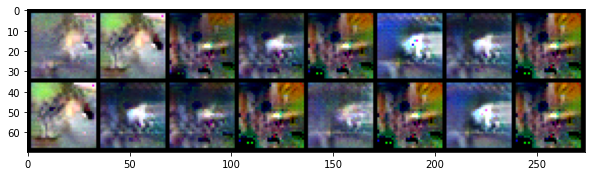

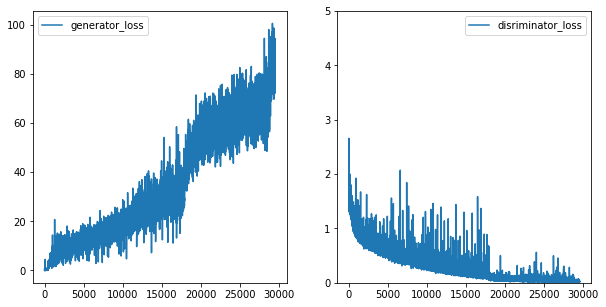


Test set: Average loss: 1.1618, Accuracy: 3812/5000 (76%)


Test set: Average loss: 3.7933, Accuracy: 5265/10000 (53%)

ETA of completion: 669.5666001796723 minutes: curr_epoch 76


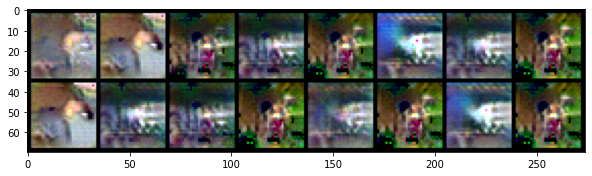

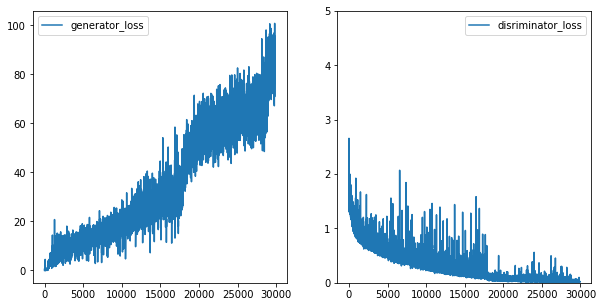


Test set: Average loss: 1.0592, Accuracy: 3887/5000 (78%)


Test set: Average loss: 3.8180, Accuracy: 5325/10000 (53%)

ETA of completion: 667.1376342376074 minutes: curr_epoch 77


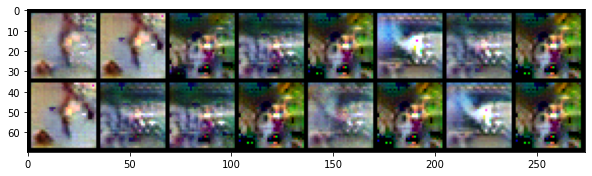

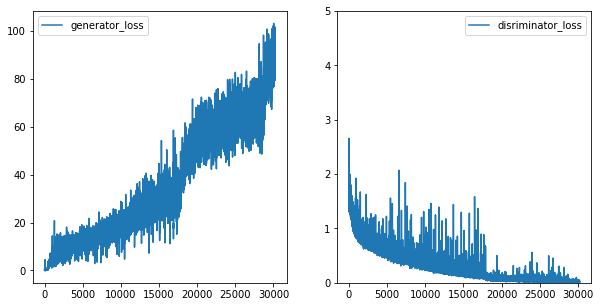


Test set: Average loss: 1.1971, Accuracy: 3755/5000 (75%)


Test set: Average loss: 3.9518, Accuracy: 5222/10000 (52%)

ETA of completion: 661.8653731584549 minutes: curr_epoch 78


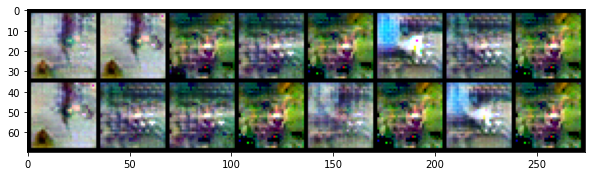

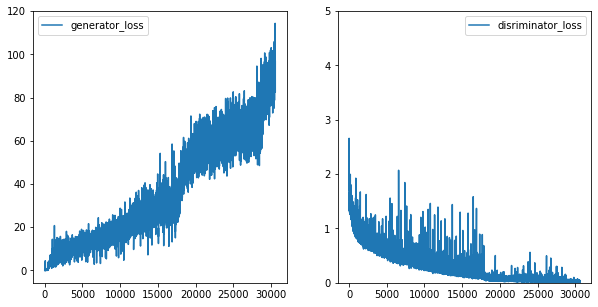


Test set: Average loss: 1.5338, Accuracy: 3639/5000 (73%)


Test set: Average loss: 4.2769, Accuracy: 5160/10000 (52%)

ETA of completion: 660.0432542125384 minutes: curr_epoch 79


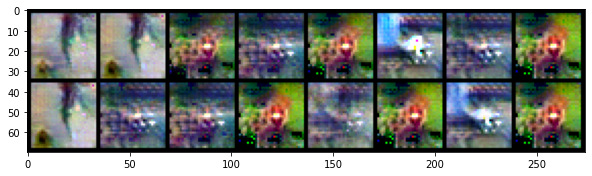

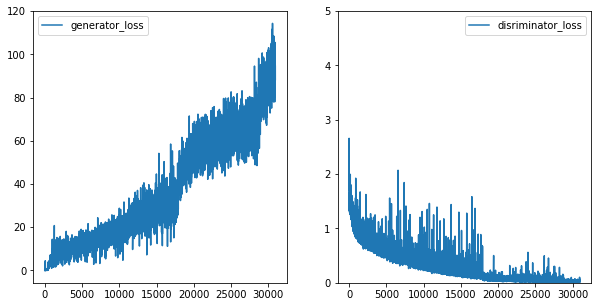


Test set: Average loss: 1.3405, Accuracy: 3685/5000 (74%)


Test set: Average loss: 4.0515, Accuracy: 5197/10000 (52%)

ETA of completion: 660.4052157402039 minutes: curr_epoch 80


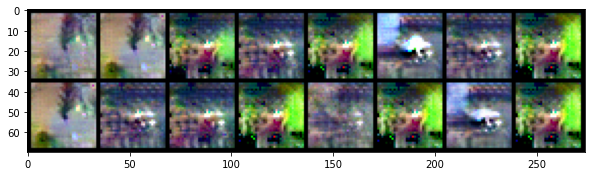

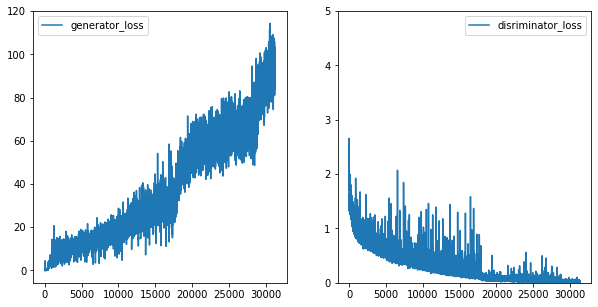


Test set: Average loss: 1.2992, Accuracy: 3758/5000 (75%)


Test set: Average loss: 4.0187, Accuracy: 5229/10000 (52%)

ETA of completion: 669.2468548893928 minutes: curr_epoch 81


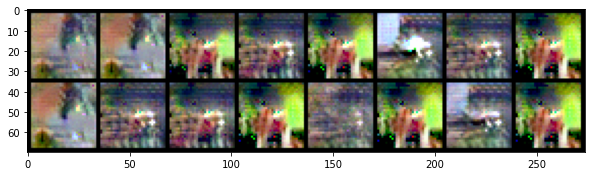

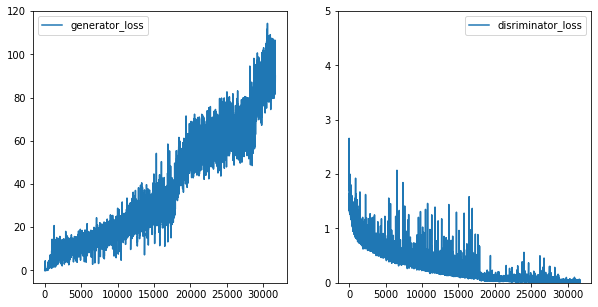


Test set: Average loss: 1.2879, Accuracy: 3761/5000 (75%)


Test set: Average loss: 4.1093, Accuracy: 5179/10000 (52%)

ETA of completion: 669.4728508154551 minutes: curr_epoch 82


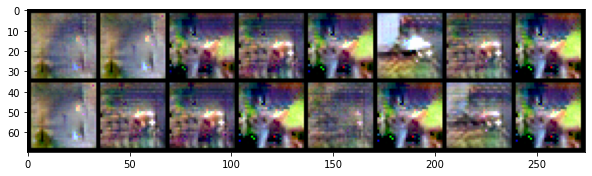

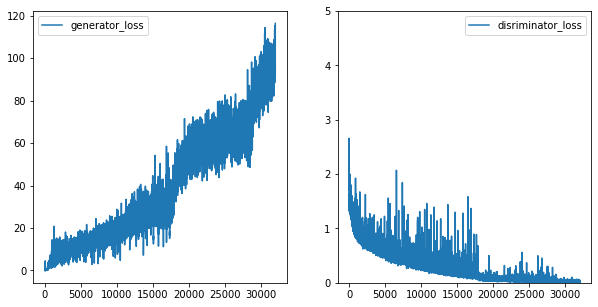


Test set: Average loss: 1.2926, Accuracy: 3685/5000 (74%)


Test set: Average loss: 3.9703, Accuracy: 5192/10000 (52%)

ETA of completion: 659.5853117863337 minutes: curr_epoch 83


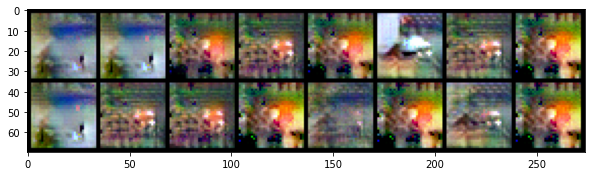

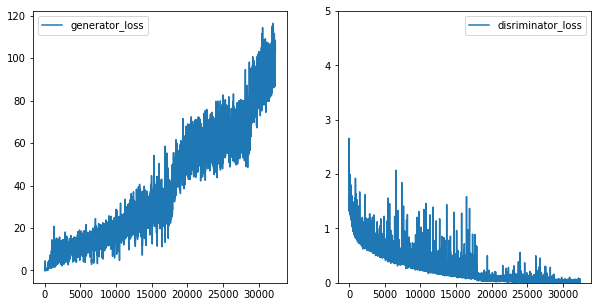


Test set: Average loss: 1.4085, Accuracy: 3717/5000 (74%)


Test set: Average loss: 4.1764, Accuracy: 5148/10000 (51%)

ETA of completion: 657.6589098930359 minutes: curr_epoch 84


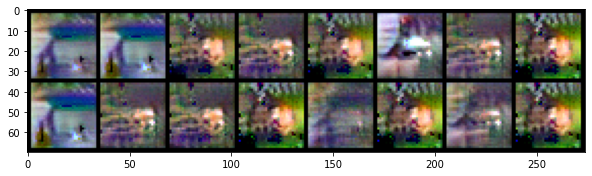

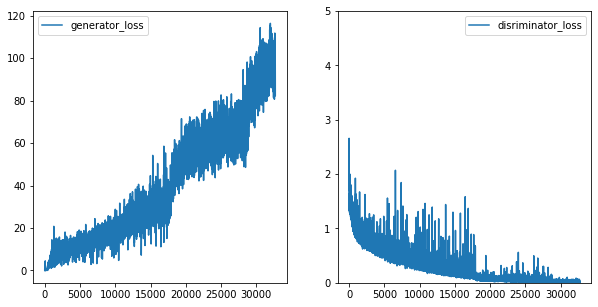


Test set: Average loss: 1.3391, Accuracy: 3735/5000 (75%)


Test set: Average loss: 4.2249, Accuracy: 5227/10000 (52%)

ETA of completion: 655.2605290015539 minutes: curr_epoch 85


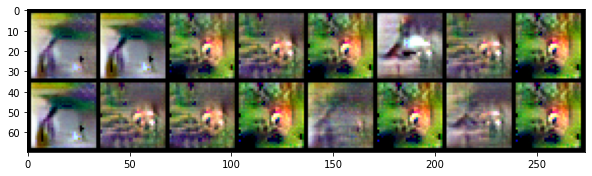

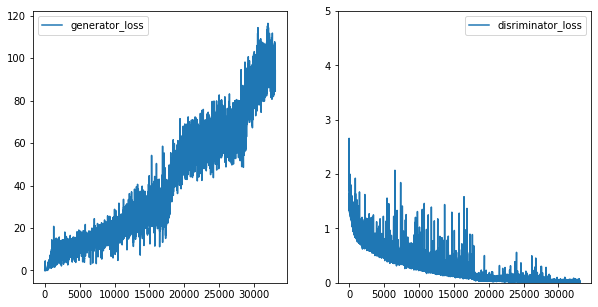


Test set: Average loss: 1.4186, Accuracy: 3703/5000 (74%)


Test set: Average loss: 4.3349, Accuracy: 5106/10000 (51%)

ETA of completion: 652.786072619756 minutes: curr_epoch 86


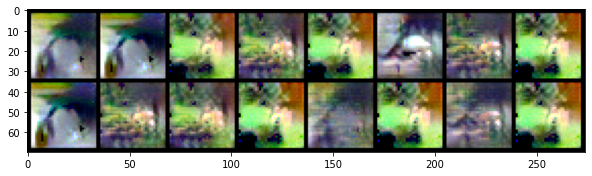

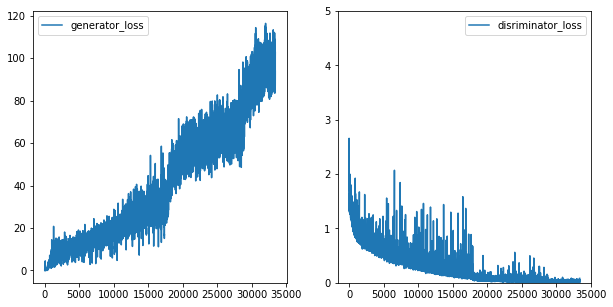


Test set: Average loss: 1.4845, Accuracy: 3693/5000 (74%)


Test set: Average loss: 4.3830, Accuracy: 5162/10000 (52%)

ETA of completion: 654.2072157382966 minutes: curr_epoch 87


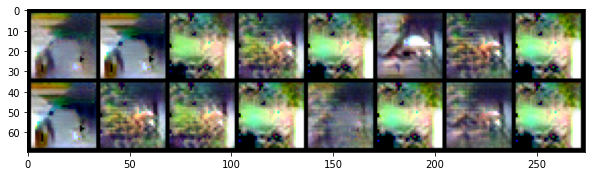

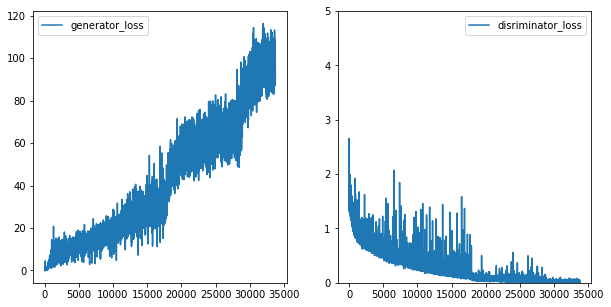


Test set: Average loss: 1.1658, Accuracy: 3857/5000 (77%)


Test set: Average loss: 4.1195, Accuracy: 5307/10000 (53%)

ETA of completion: 649.7627461751302 minutes: curr_epoch 88


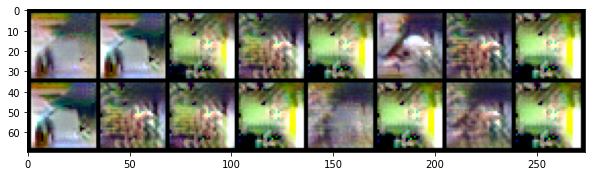

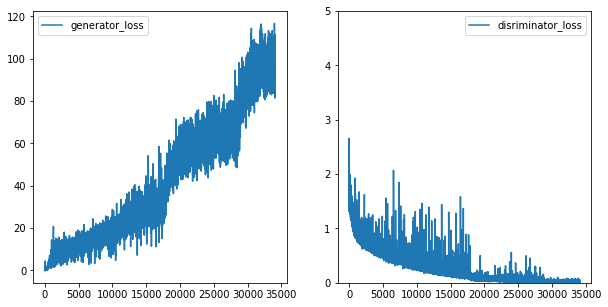


Test set: Average loss: 1.1725, Accuracy: 3877/5000 (78%)


Test set: Average loss: 4.1356, Accuracy: 5288/10000 (53%)

ETA of completion: 648.2297701239586 minutes: curr_epoch 89


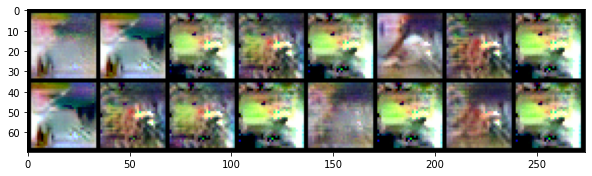

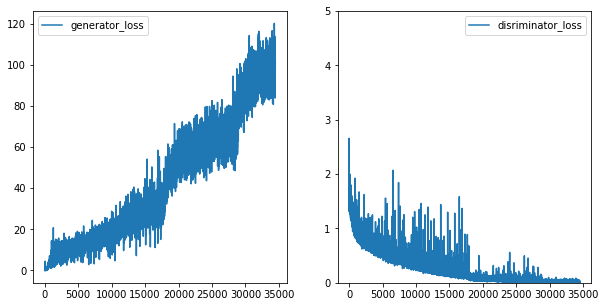


Test set: Average loss: 1.2987, Accuracy: 3769/5000 (75%)


Test set: Average loss: 4.1091, Accuracy: 5199/10000 (52%)

ETA of completion: 648.0213395357132 minutes: curr_epoch 90


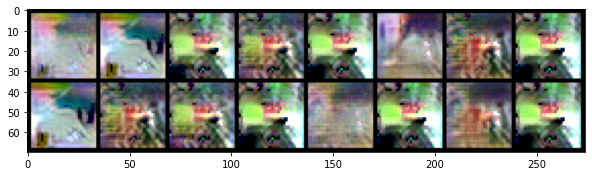

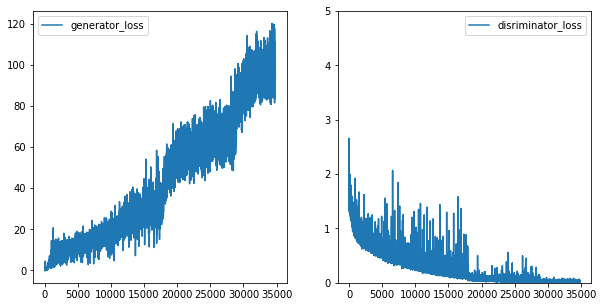


Test set: Average loss: 1.2583, Accuracy: 3824/5000 (76%)


Test set: Average loss: 4.2589, Accuracy: 5221/10000 (52%)

ETA of completion: 645.0282160083453 minutes: curr_epoch 91


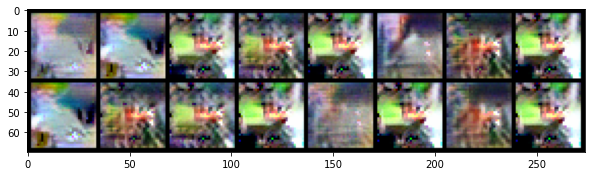

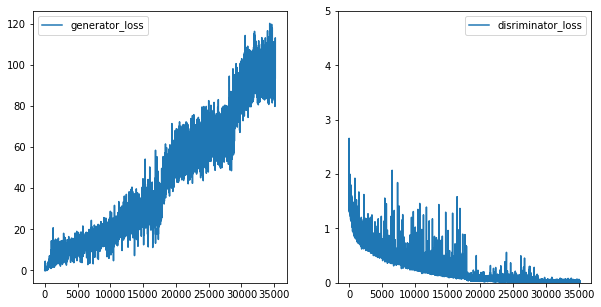


Test set: Average loss: 1.0884, Accuracy: 3885/5000 (78%)


Test set: Average loss: 4.0434, Accuracy: 5355/10000 (54%)

ETA of completion: 644.5053124904632 minutes: curr_epoch 92


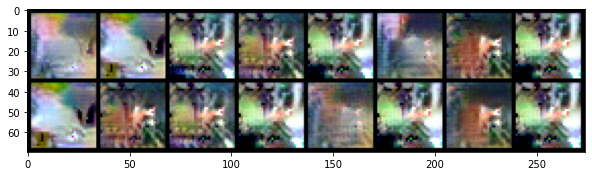

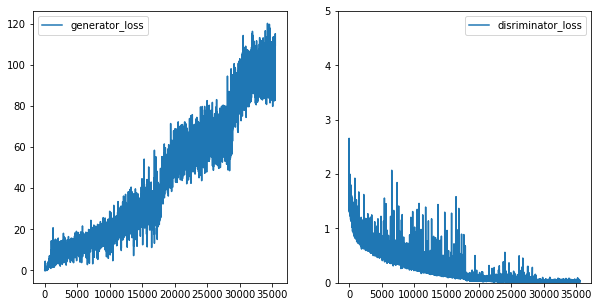


Test set: Average loss: 1.1047, Accuracy: 3857/5000 (77%)


Test set: Average loss: 3.9723, Accuracy: 5306/10000 (53%)

ETA of completion: 641.8856219410897 minutes: curr_epoch 93


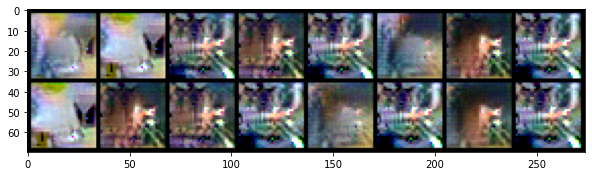

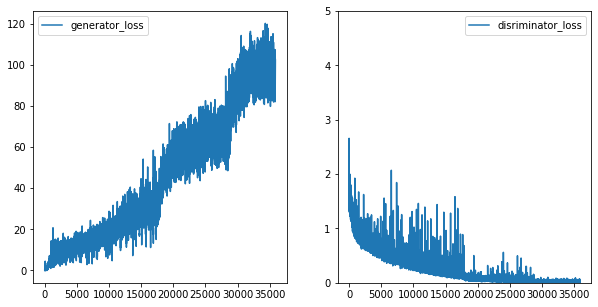


Test set: Average loss: 1.1790, Accuracy: 3808/5000 (76%)


Test set: Average loss: 3.9994, Accuracy: 5231/10000 (52%)

ETA of completion: 639.4490194241206 minutes: curr_epoch 94


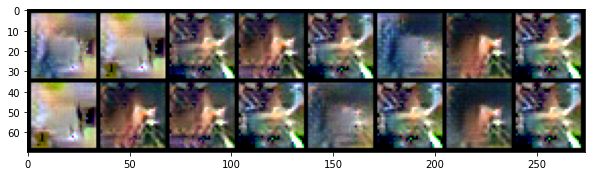

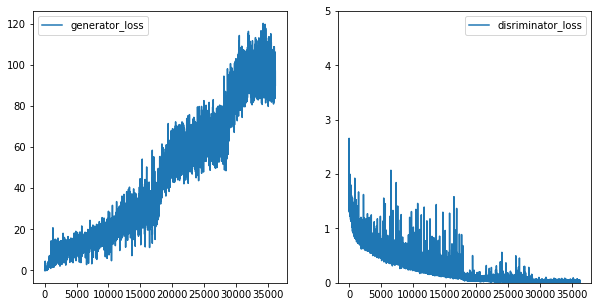


Test set: Average loss: 0.8936, Accuracy: 4047/5000 (81%)


Test set: Average loss: 4.0106, Accuracy: 5342/10000 (53%)

ETA of completion: 643.4002312620481 minutes: curr_epoch 95


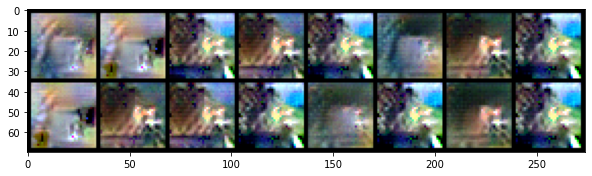

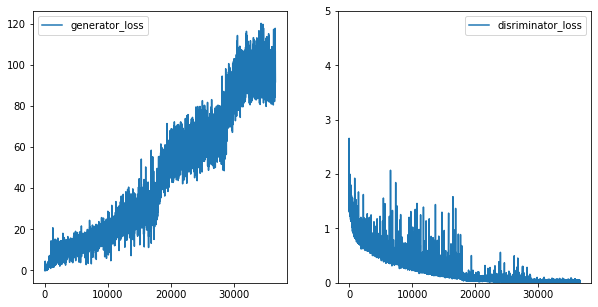


Test set: Average loss: 1.0538, Accuracy: 3902/5000 (78%)


Test set: Average loss: 3.9138, Accuracy: 5327/10000 (53%)

ETA of completion: 644.1685392379761 minutes: curr_epoch 96


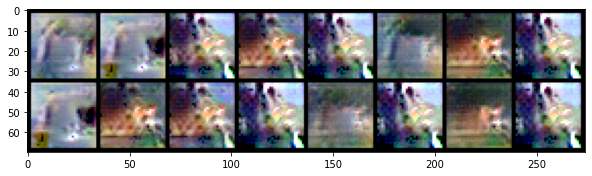

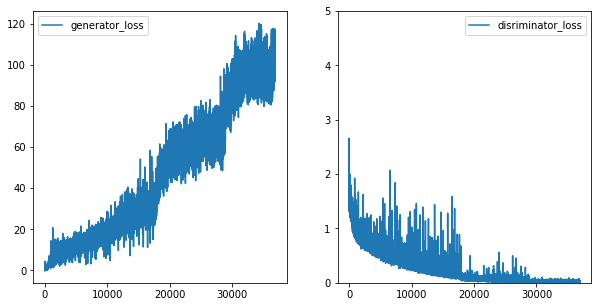


Test set: Average loss: 1.0578, Accuracy: 3946/5000 (79%)


Test set: Average loss: 4.0576, Accuracy: 5374/10000 (54%)

ETA of completion: 640.6938311219216 minutes: curr_epoch 97


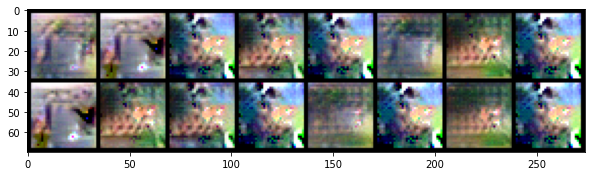

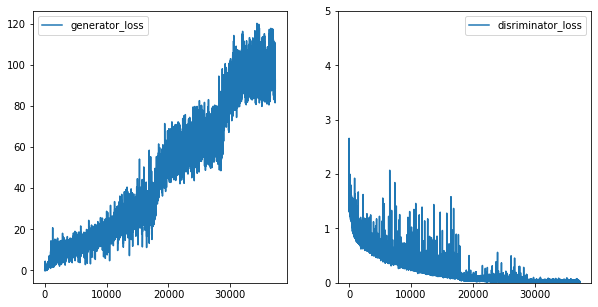


Test set: Average loss: 1.3648, Accuracy: 3744/5000 (75%)


Test set: Average loss: 4.3200, Accuracy: 5211/10000 (52%)

ETA of completion: 637.2491112470627 minutes: curr_epoch 98


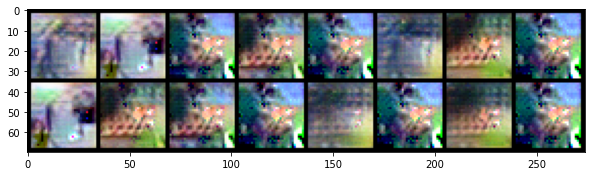

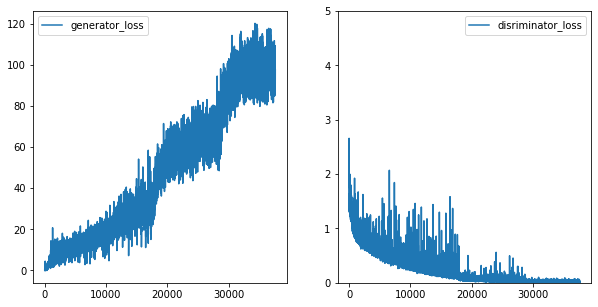


Test set: Average loss: 1.2461, Accuracy: 3842/5000 (77%)


Test set: Average loss: 4.2159, Accuracy: 5290/10000 (53%)

ETA of completion: 636.2560309886933 minutes: curr_epoch 99


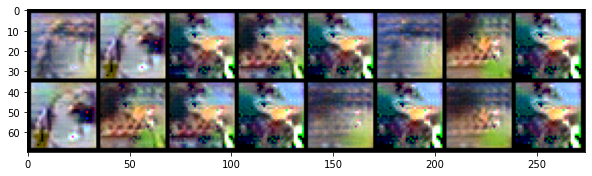

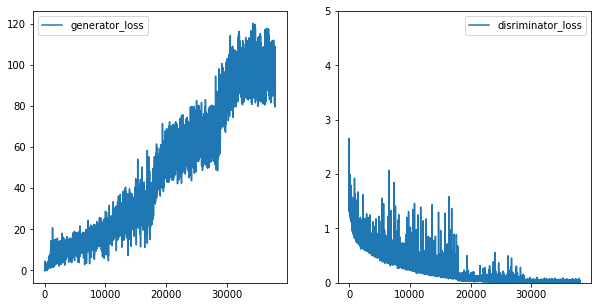


Test set: Average loss: 0.9799, Accuracy: 3989/5000 (80%)


Test set: Average loss: 3.9448, Accuracy: 5367/10000 (54%)

ETA of completion: 634.8202586174011 minutes: curr_epoch 100


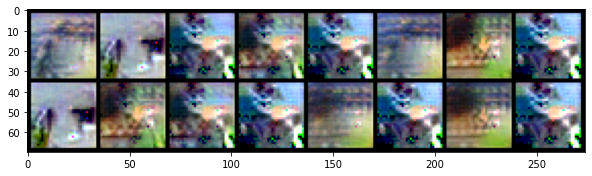

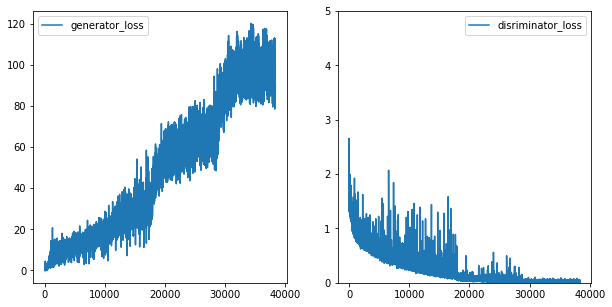


Test set: Average loss: 1.0716, Accuracy: 3935/5000 (79%)


Test set: Average loss: 4.1074, Accuracy: 5347/10000 (53%)

ETA of completion: 638.0107805331548 minutes: curr_epoch 101


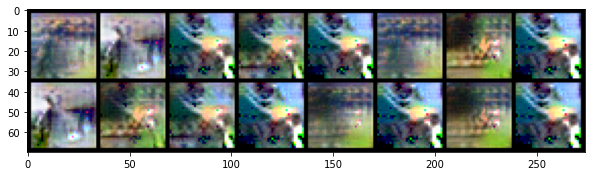

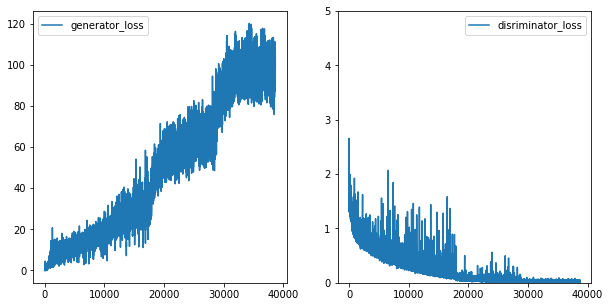


Test set: Average loss: 1.3773, Accuracy: 3756/5000 (75%)


Test set: Average loss: 4.4433, Accuracy: 5236/10000 (52%)

ETA of completion: 629.6600081682205 minutes: curr_epoch 102


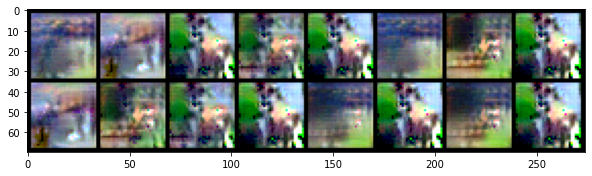

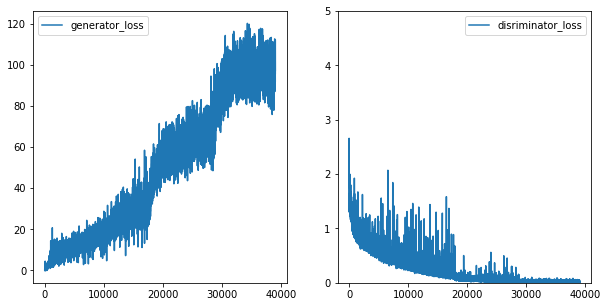


Test set: Average loss: 1.2249, Accuracy: 3819/5000 (76%)


Test set: Average loss: 4.2107, Accuracy: 5324/10000 (53%)

ETA of completion: 632.1836558143298 minutes: curr_epoch 103


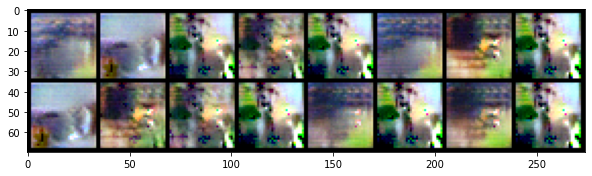

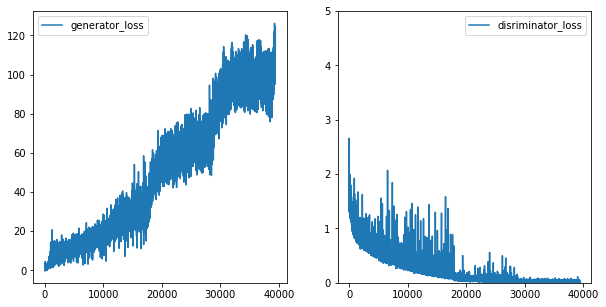


Test set: Average loss: 1.0263, Accuracy: 3962/5000 (79%)


Test set: Average loss: 4.0695, Accuracy: 5348/10000 (53%)

Epoch 00112: reducing learning rate of group 0 to 3.7500e-05.
Epoch 00112: reducing learning rate of group 0 to 3.7500e-05.
ETA of completion: 629.328511428833 minutes: curr_epoch 104


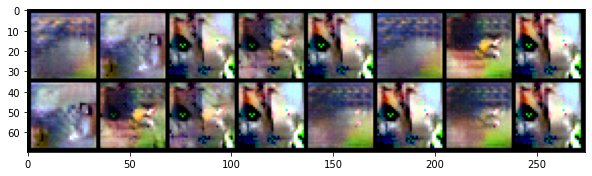

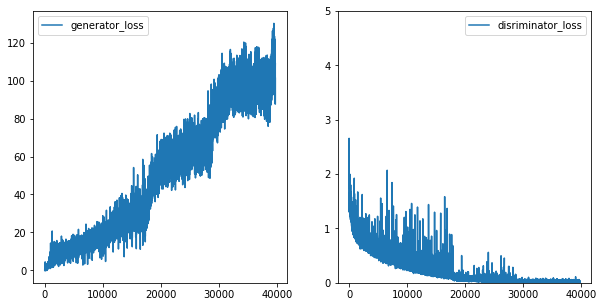


Test set: Average loss: 1.1570, Accuracy: 3904/5000 (78%)


Test set: Average loss: 4.2697, Accuracy: 5307/10000 (53%)

ETA of completion: 627.6680737137794 minutes: curr_epoch 105


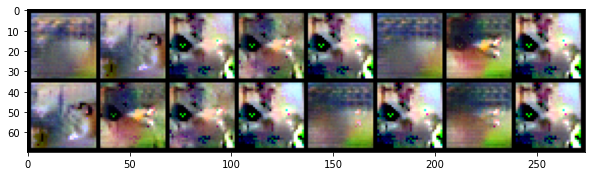

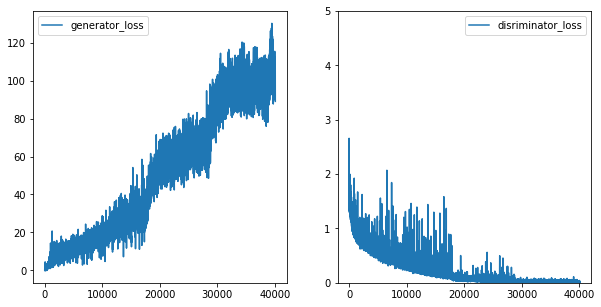


Test set: Average loss: 1.2816, Accuracy: 3834/5000 (77%)


Test set: Average loss: 4.4638, Accuracy: 5261/10000 (53%)

ETA of completion: 628.0147357463836 minutes: curr_epoch 106


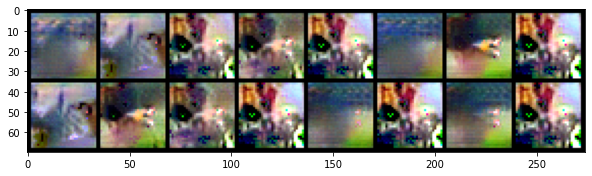

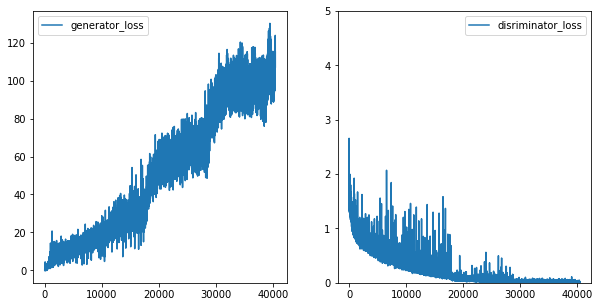


Test set: Average loss: 1.1040, Accuracy: 3981/5000 (80%)


Test set: Average loss: 4.3335, Accuracy: 5362/10000 (54%)

ETA of completion: 624.7496823032697 minutes: curr_epoch 107


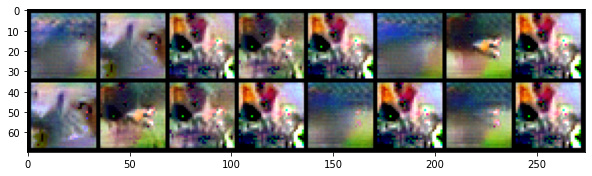

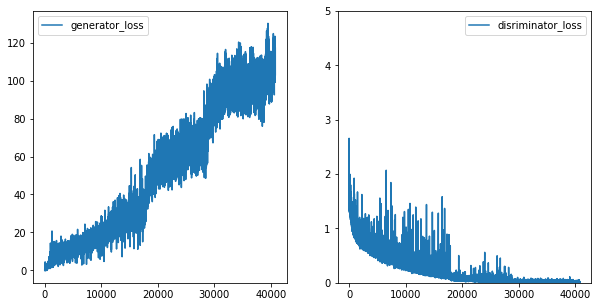


Test set: Average loss: 1.3784, Accuracy: 3791/5000 (76%)


Test set: Average loss: 4.6307, Accuracy: 5263/10000 (53%)

ETA of completion: 626.0753736019135 minutes: curr_epoch 108


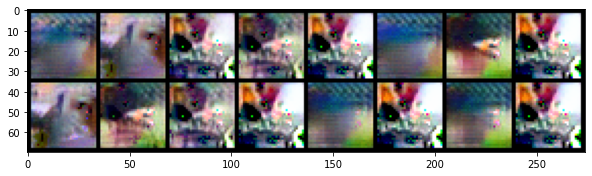

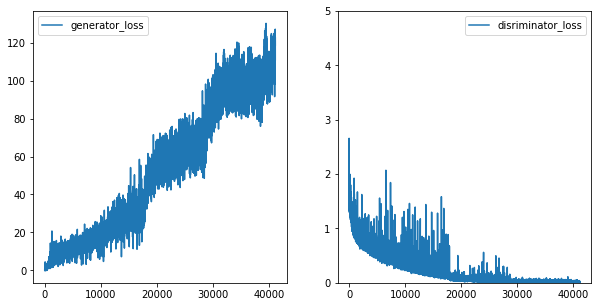


Test set: Average loss: 1.2160, Accuracy: 3880/5000 (78%)


Test set: Average loss: 4.4966, Accuracy: 5292/10000 (53%)

ETA of completion: 623.4198878844579 minutes: curr_epoch 109


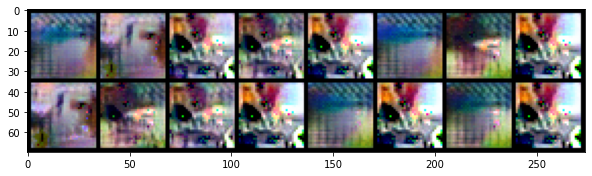

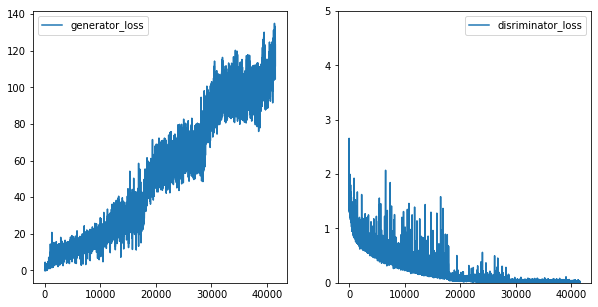


Test set: Average loss: 1.3277, Accuracy: 3833/5000 (77%)


Test set: Average loss: 4.6015, Accuracy: 5251/10000 (53%)

ETA of completion: 620.2107683817545 minutes: curr_epoch 110


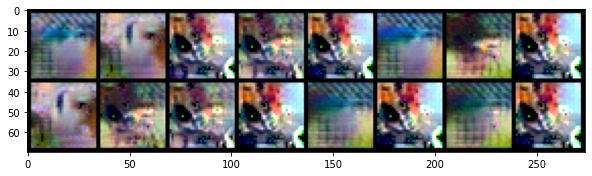

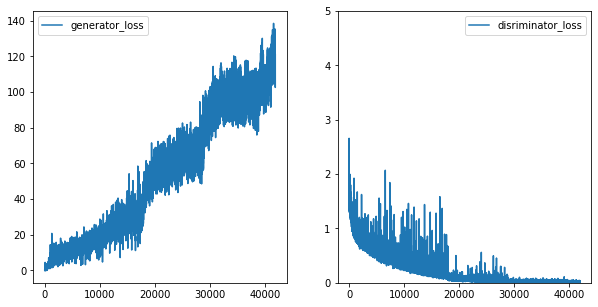


Test set: Average loss: 1.1736, Accuracy: 3911/5000 (78%)


Test set: Average loss: 4.5388, Accuracy: 5308/10000 (53%)

ETA of completion: 618.0396743297576 minutes: curr_epoch 111


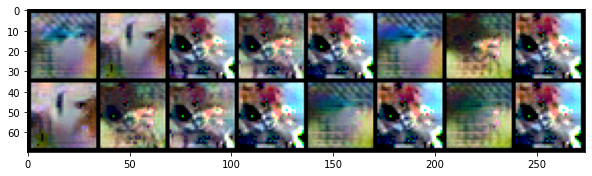

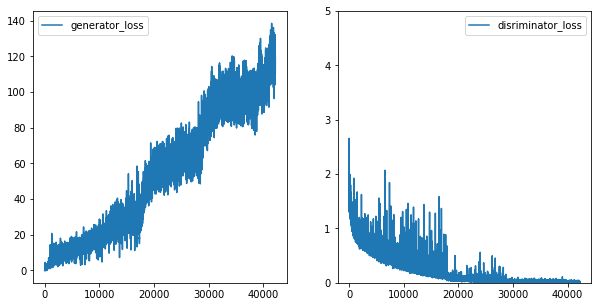


Test set: Average loss: 1.2591, Accuracy: 3876/5000 (78%)


Test set: Average loss: 4.6278, Accuracy: 5254/10000 (53%)

ETA of completion: 618.3087108929952 minutes: curr_epoch 112


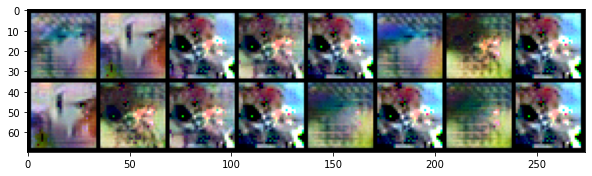

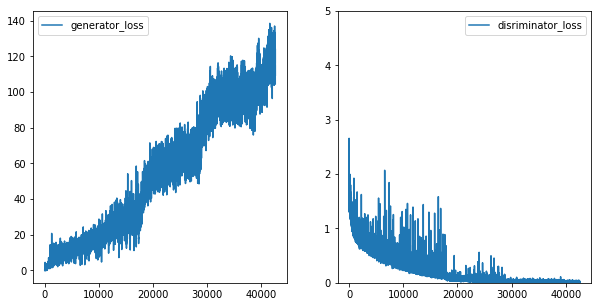


Test set: Average loss: 1.2383, Accuracy: 3898/5000 (78%)


Test set: Average loss: 4.5737, Accuracy: 5313/10000 (53%)

ETA of completion: 615.6006029486656 minutes: curr_epoch 113


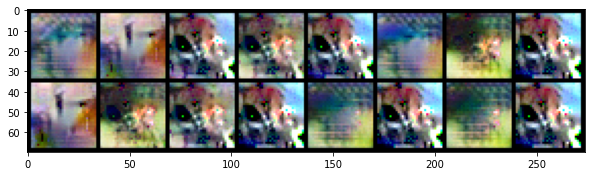

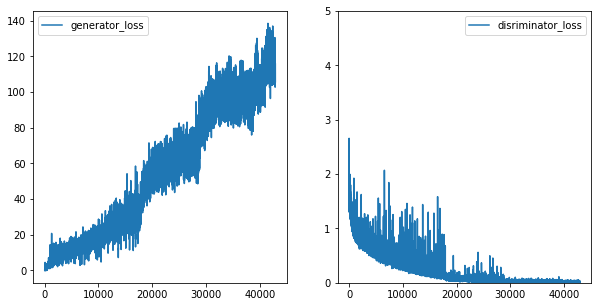


Test set: Average loss: 1.3557, Accuracy: 3789/5000 (76%)


Test set: Average loss: 4.7172, Accuracy: 5215/10000 (52%)

ETA of completion: 617.4242334365845 minutes: curr_epoch 114


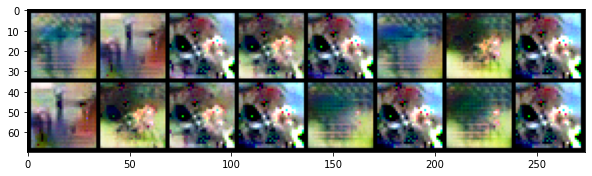

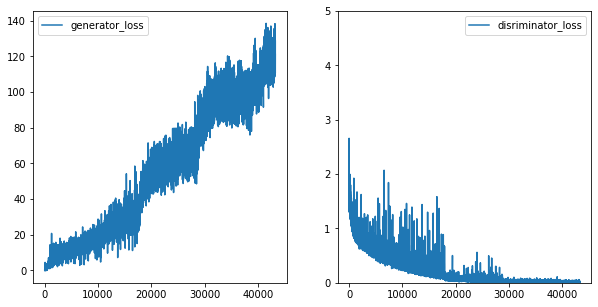


Test set: Average loss: 1.2438, Accuracy: 3873/5000 (77%)


Test set: Average loss: 4.4844, Accuracy: 5324/10000 (53%)

ETA of completion: 617.2212234536806 minutes: curr_epoch 115


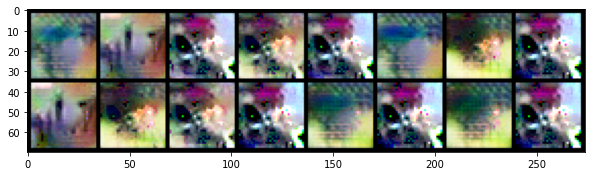

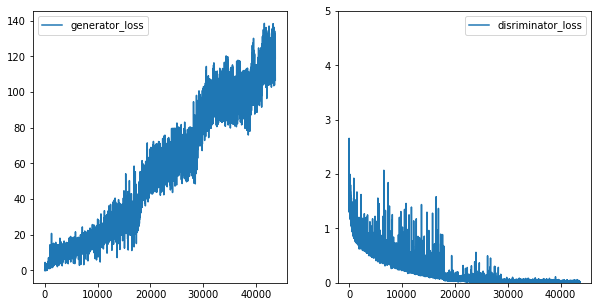


Test set: Average loss: 1.3028, Accuracy: 3851/5000 (77%)


Test set: Average loss: 4.5953, Accuracy: 5268/10000 (53%)

ETA of completion: 616.416423590978 minutes: curr_epoch 116


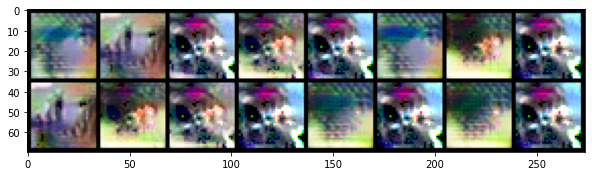

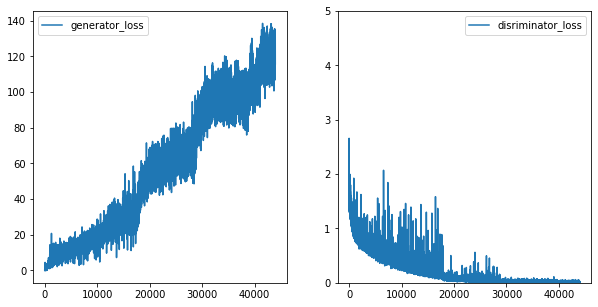


Test set: Average loss: 1.2426, Accuracy: 3896/5000 (78%)


Test set: Average loss: 4.4834, Accuracy: 5359/10000 (54%)

ETA of completion: 615.2072830915452 minutes: curr_epoch 117


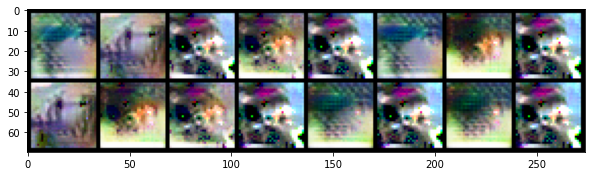

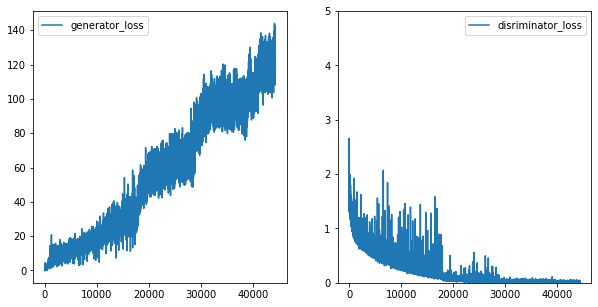


Test set: Average loss: 1.2175, Accuracy: 3889/5000 (78%)


Test set: Average loss: 4.6438, Accuracy: 5248/10000 (52%)

ETA of completion: 615.2548518816631 minutes: curr_epoch 118


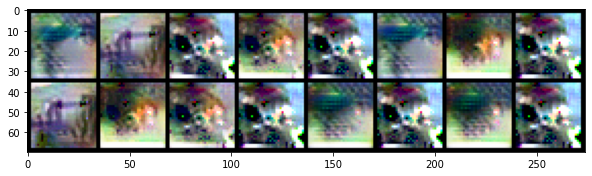

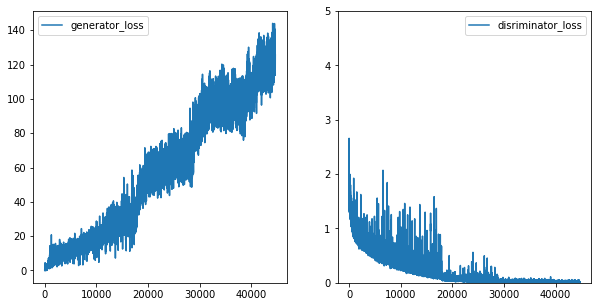


Test set: Average loss: 1.3542, Accuracy: 3839/5000 (77%)


Test set: Average loss: 4.6731, Accuracy: 5246/10000 (52%)

ETA of completion: 611.1039424061776 minutes: curr_epoch 119


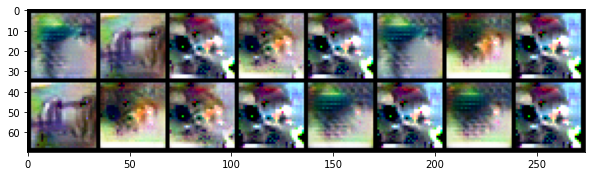

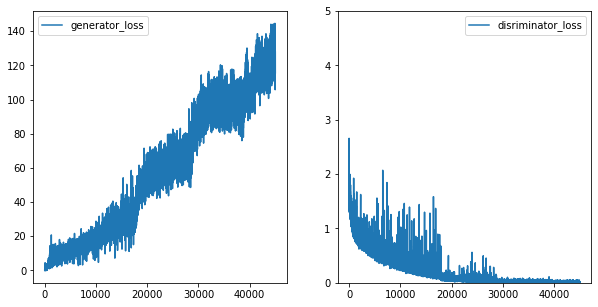


Test set: Average loss: 1.2532, Accuracy: 3929/5000 (79%)


Test set: Average loss: 4.5863, Accuracy: 5319/10000 (53%)

ETA of completion: 608.884147644043 minutes: curr_epoch 120


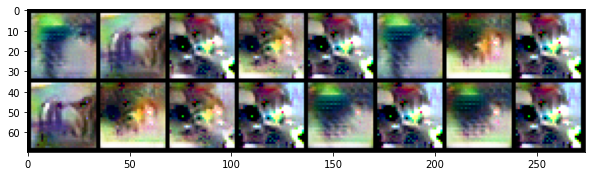

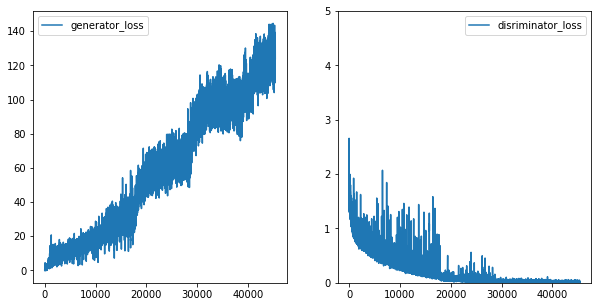


Test set: Average loss: 1.1952, Accuracy: 3933/5000 (79%)


Test set: Average loss: 4.5307, Accuracy: 5321/10000 (53%)

ETA of completion: 610.6694614211718 minutes: curr_epoch 121


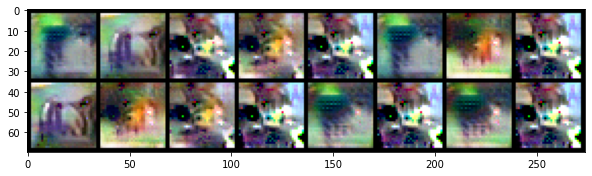

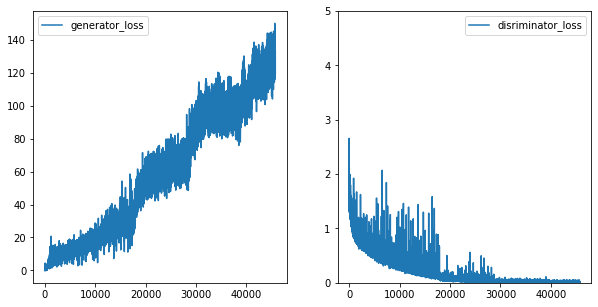


Test set: Average loss: 1.1833, Accuracy: 3942/5000 (79%)


Test set: Average loss: 4.5570, Accuracy: 5310/10000 (53%)

ETA of completion: 607.2607595046361 minutes: curr_epoch 122


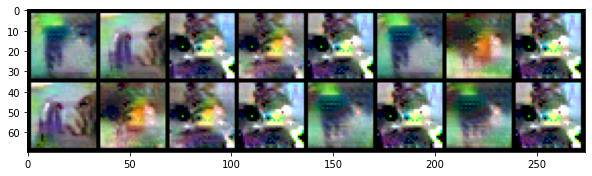

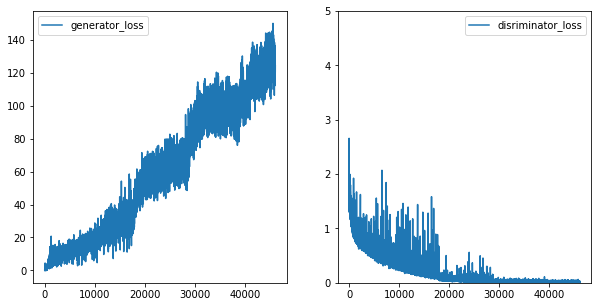


Test set: Average loss: 1.4113, Accuracy: 3818/5000 (76%)


Test set: Average loss: 4.7322, Accuracy: 5221/10000 (52%)

ETA of completion: 606.5305724143982 minutes: curr_epoch 123


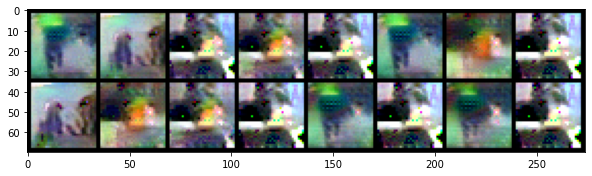

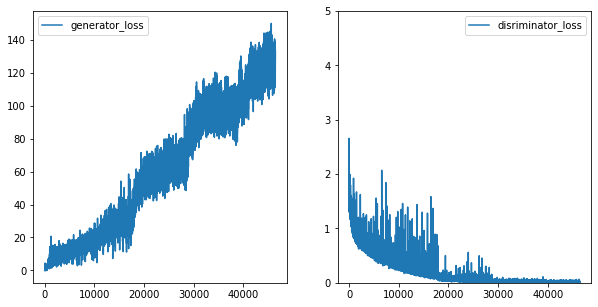


Test set: Average loss: 1.2819, Accuracy: 3876/5000 (78%)


Test set: Average loss: 4.6886, Accuracy: 5279/10000 (53%)

ETA of completion: 604.7451855500539 minutes: curr_epoch 124


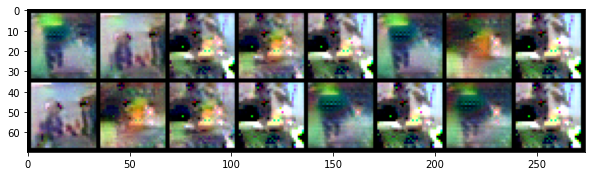

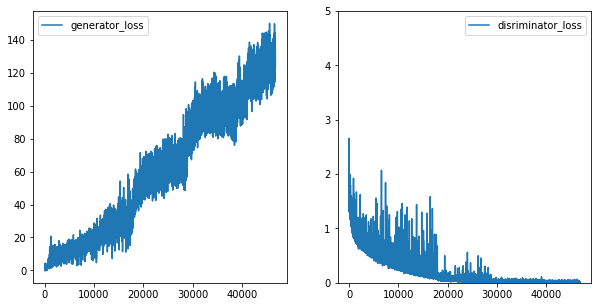


Test set: Average loss: 1.2574, Accuracy: 3886/5000 (78%)


Test set: Average loss: 4.5855, Accuracy: 5275/10000 (53%)

ETA of completion: 603.8014560937881 minutes: curr_epoch 125


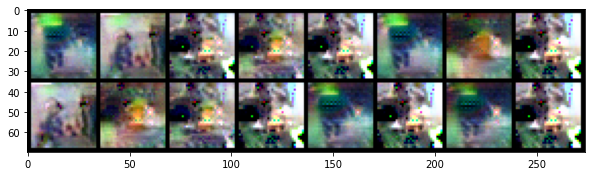

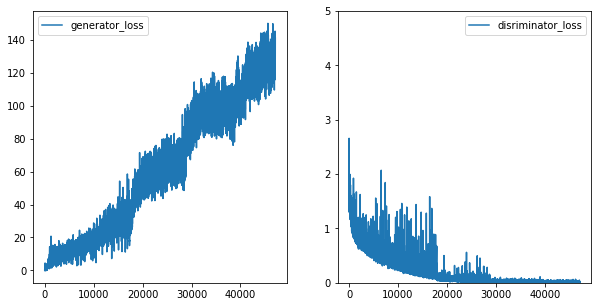


Test set: Average loss: 1.4315, Accuracy: 3836/5000 (77%)


Test set: Average loss: 4.8446, Accuracy: 5222/10000 (52%)

ETA of completion: 603.1638634920121 minutes: curr_epoch 126


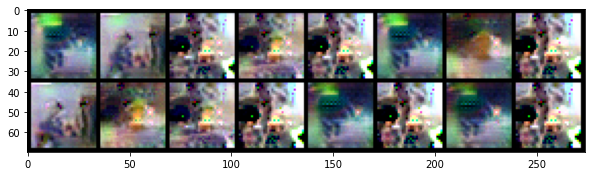

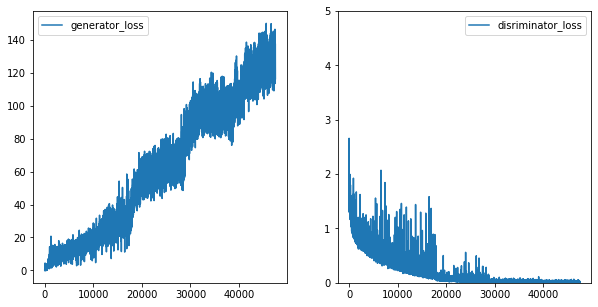


Test set: Average loss: 1.2953, Accuracy: 3892/5000 (78%)


Test set: Average loss: 4.6585, Accuracy: 5315/10000 (53%)

ETA of completion: 602.0521148403485 minutes: curr_epoch 127


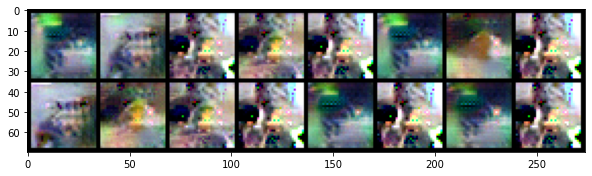

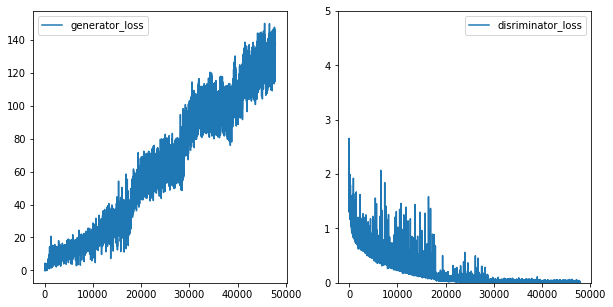


Test set: Average loss: 1.2140, Accuracy: 3905/5000 (78%)


Test set: Average loss: 4.5799, Accuracy: 5262/10000 (53%)

ETA of completion: 606.9545945167541 minutes: curr_epoch 128


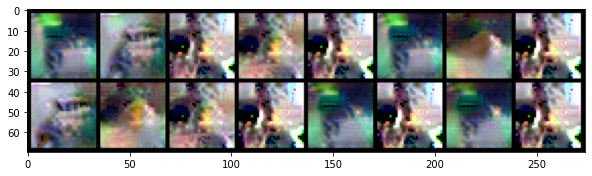

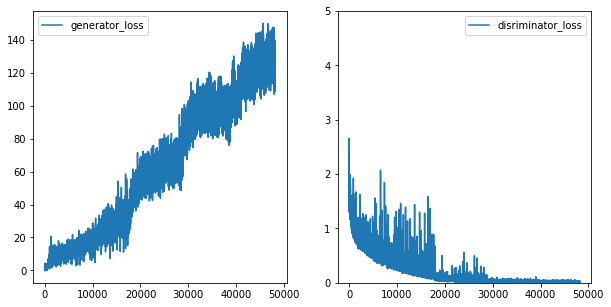


Test set: Average loss: 1.3042, Accuracy: 3857/5000 (77%)


Test set: Average loss: 4.6952, Accuracy: 5290/10000 (53%)

ETA of completion: 604.444568657875 minutes: curr_epoch 129


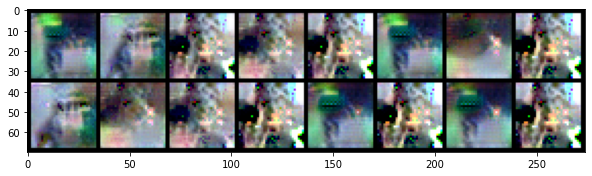

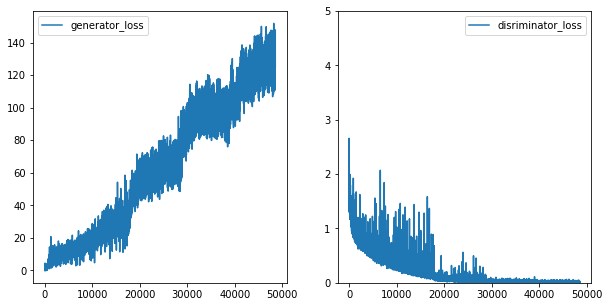


Test set: Average loss: 1.5088, Accuracy: 3792/5000 (76%)


Test set: Average loss: 4.8235, Accuracy: 5235/10000 (52%)

ETA of completion: 598.9097864230474 minutes: curr_epoch 130


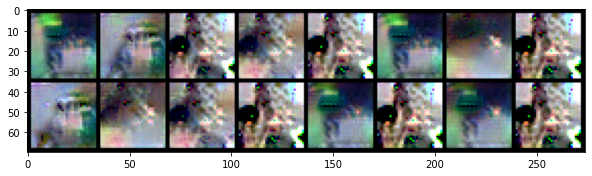

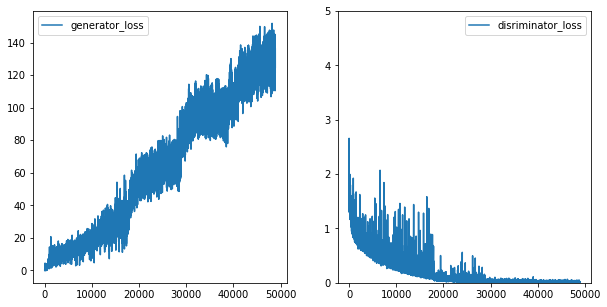


Test set: Average loss: 1.4797, Accuracy: 3804/5000 (76%)


Test set: Average loss: 4.9126, Accuracy: 5197/10000 (52%)

ETA of completion: 595.0630796591441 minutes: curr_epoch 131


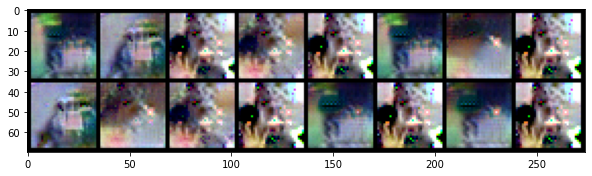

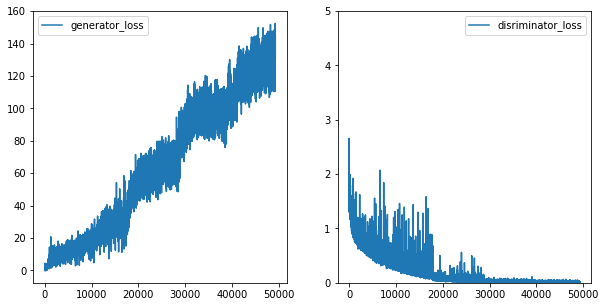


Test set: Average loss: 1.3293, Accuracy: 3850/5000 (77%)


Test set: Average loss: 4.7620, Accuracy: 5245/10000 (52%)

ETA of completion: 593.8934904098511 minutes: curr_epoch 132


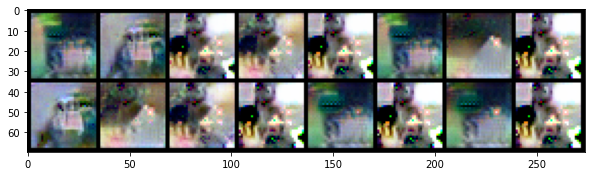

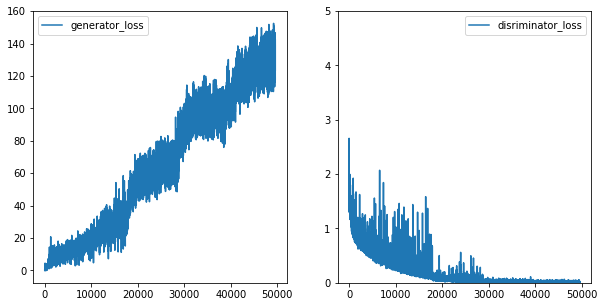


Test set: Average loss: 1.2201, Accuracy: 3934/5000 (79%)


Test set: Average loss: 4.6487, Accuracy: 5331/10000 (53%)

ETA of completion: 592.8467081109683 minutes: curr_epoch 133


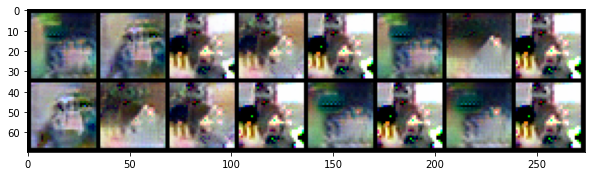

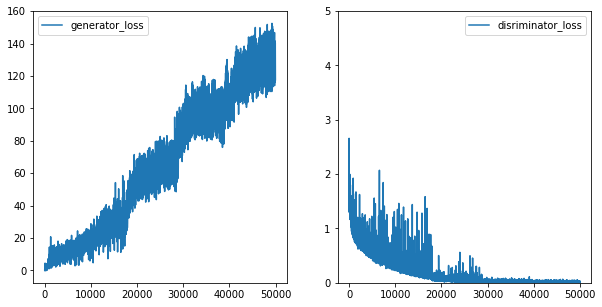


Test set: Average loss: 1.5369, Accuracy: 3838/5000 (77%)


Test set: Average loss: 4.8467, Accuracy: 5250/10000 (52%)

ETA of completion: 591.726151617368 minutes: curr_epoch 134


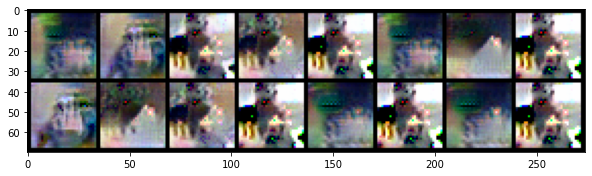

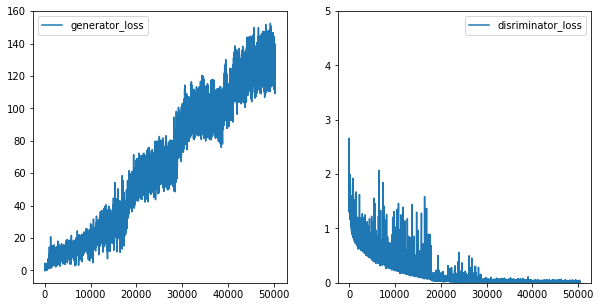


Test set: Average loss: 1.2837, Accuracy: 3894/5000 (78%)


Test set: Average loss: 4.7178, Accuracy: 5334/10000 (53%)

Epoch 00143: reducing learning rate of group 0 to 1.8750e-05.
Epoch 00143: reducing learning rate of group 0 to 1.8750e-05.
ETA of completion: 589.5421650409698 minutes: curr_epoch 135


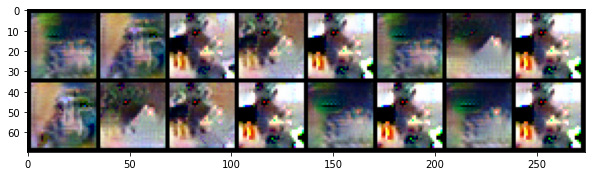

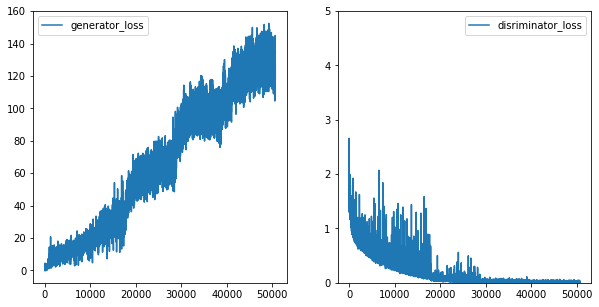


Test set: Average loss: 1.5251, Accuracy: 3800/5000 (76%)


Test set: Average loss: 4.8962, Accuracy: 5215/10000 (52%)

ETA of completion: 589.109009106954 minutes: curr_epoch 136


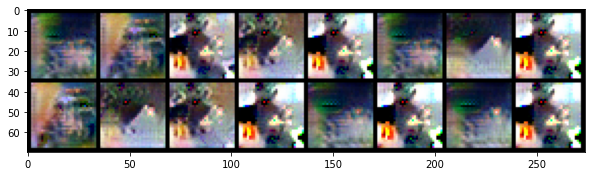

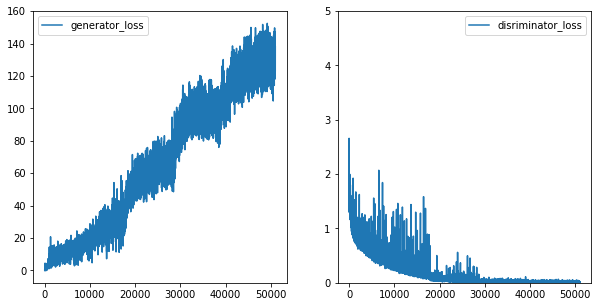


Test set: Average loss: 1.2934, Accuracy: 3906/5000 (78%)


Test set: Average loss: 4.8200, Accuracy: 5317/10000 (53%)

ETA of completion: 589.7666824142138 minutes: curr_epoch 137


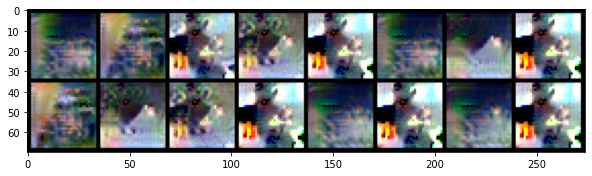

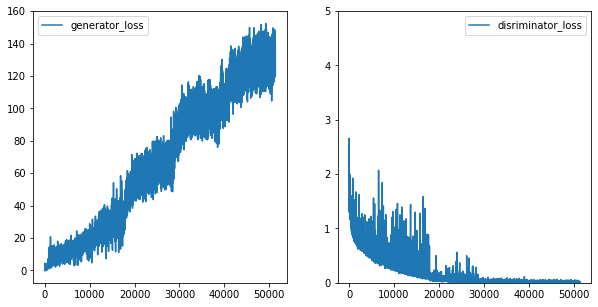


Test set: Average loss: 1.4358, Accuracy: 3831/5000 (77%)


Test set: Average loss: 4.9951, Accuracy: 5253/10000 (53%)

ETA of completion: 586.557961988449 minutes: curr_epoch 138


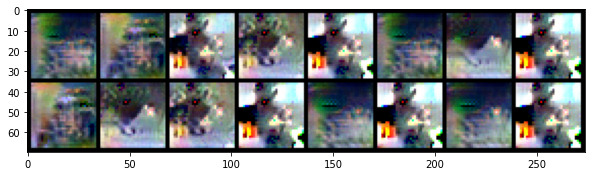

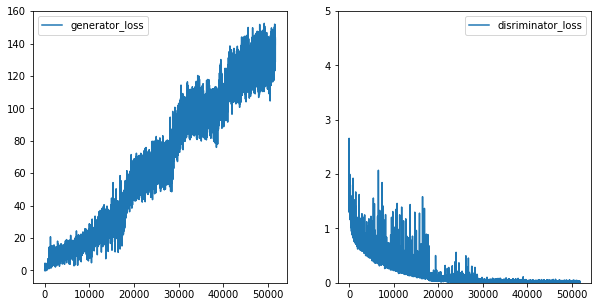

KeyboardInterrupt: ignored

In [ ]:
for epoch in range(num_epochs):
    time1 = time.time()

    for u_data, _ in u_train_dataloader:

        l_data, label = next(iter(l_train_dataloader))
        
        u_data = u_data.cuda()
        l_data = l_data.cuda()
        label = label.cuda()
        noise = torch.randn(u_data.size(0), nz).cuda() #label or unlabel

        netDC.train()
        optimizer_DC.zero_grad()

        _,l_logit = netDC(l_data)
        _,u_logit = netDC(u_data)
        generated = netG(noise)
        _,fake_logit = netDC(generated.detach())

        loss_D = 0.5*wasserstein_loss(log_sum_exp(u_logit)-F.softplus(log_sum_exp(u_logit)),-1)+0.5*wasserstein_loss(F.softplus(log_sum_exp(fake_logit) ), 1)
        loss_C = criterion_C(l_logit, label)
        
        loss_DC = 0.5*loss_D + 0.5*loss_C
        loss_DC.backward()
        optimizer_DC.step()
        DC_losses.append(loss_DC.item())


        optimizer_DC.zero_grad()
        optimizer_G.zero_grad()
        generated = netG(noise)
        feature_fake,_ = netDC(generated)
        feature_real,_ = netDC(u_data)

        loss_G = criterion_G(torch.mean(feature_fake,dim=0) ,torch.mean(feature_real,dim=0))
        loss_G.backward()
        optimizer_G.step()
        G_losses.append(loss_G.item())
    
    
    with torch.no_grad():
        netDC.eval()
        test(netDC, l_train_dataloader, len(train_labeled_dataset), True)
        val_loss, val_accuracy = test(netDC, test_dataloader, len(test_dataset), True)
    scheduler_DC.step(val_loss)
    scheduler_G.step(val_loss)

    if val_accuracy > best_acc:
        best_acc = val_accuracy
        best_classifier_wts = copy.deepcopy(netDC.state_dict())
        best_generator_wts = copy.deepcopy(netG.state_dict())
        torch.save(best_generator_wts, '/content/drive/MyDrive/JHU_courses/MLDL/Final Project/MLDL/cifar/model/netG_cifar_10_500pc_Harry.pth')
        torch.save(best_classifier_wts, '/content/drive/MyDrive/JHU_courses/MLDL/Final Project/MLDL/cifar/model/classifier_cifar_10_500pc_Harry.pth')



    time2 = time.time()
    print('ETA of completion:',(time2 - time1)*(num_epochs - epoch)/60,'minutes: curr_epoch',epoch)
    fig = plt.figure(figsize=(10,5))
    generated = (netG(fixed_noise)+1.0)/2.0
    grid=vutils.make_grid(generated[0:16].cpu().detach())
    plt.imshow(np.transpose(grid,(1,2,0)))
    plt.show()
    fig = plt.figure(figsize=(10,5))
    plt.subplot(121)
    plt.plot(range(0,len(G_losses*train_interval_gen),train_interval_gen), np.array(G_losses),label='generator_loss')
    #plt.ylim(0,50)
    plt.legend()
    plt.subplot(122)
    plt.plot(range(0,len(DC_losses*train_interval_dis),train_interval_dis), np.array(DC_losses),label='disriminator_loss')
    plt.ylim(0,5)
    plt.legend()
    plt.show()
